<a href="https://colab.research.google.com/github/NonMundaneDev/moth_classification/blob/master/moth_classification_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Installing The Libraries and Packages

While packages and modules such as `os`, `pathlib`, and `tarfile` come in-built with Python, there are other external packages and libraries we would need to install to work on this project.

In [ ]:
# ! pip install -U pip # Update pip
# ! pip install numpy
# ! pip install -U matplotlib
# ! pip install opencv-python
# ! pip install albumentations
# ! pip install -U scikit-image
# ! pip install Pillow
# ! pip install tensorflow # Installs both TensorFlow and Keras
# ! pip install graphviz
# ! pip install pydot-ng
# ! pip install -U tensorboard_plugin_profile
# !pip install ipython-autotime # To time the cell

In [ ]:
!pip install ipython-autotime

In [ ]:
!pip install -U tensorboard_plugin_profile

     |████████████████████████████████| 1.2MB 7.6MB/s 


#### Import Necessary Libraries and Packages

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time # To help us calculate how long a process will take.

from datetime import datetime
from packaging import version

# This should import the latest version of TensorFlow (v2.3.0 as of this time)
import tensorflow as tf

# Import the Keras library for model-building usage.
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import plot_model # To plot our CNN arch graph
from keras import models


print("TensorFlow version: ", tf.__version__)
assert version.parse(tf.__version__).release[0] >= 2, \
    "This notebook requires TensorFlow 2.0 or above."

TensorFlow version:  2.4.1


In [ ]:
!pip install kora
from kora import console
console.start() 

Console URL: https://teleconsole.com/s/cbafa817382a1f8ff0b792fe80b4892150189ea8


### Hardware Details for The Training Process.


The code below can be run for any Nvidia GPU (hardware). We will use it to get information on our training hardware.

We use a Nvidia Tesla T4, with GPU information above to train our system, and then we will move on to using Nvidia Jetson Nano 4GB for local inference when we convert our final model to a lighter one that can run on edge devices like it (the Nvidia Jetson Nano). 

In [ ]:
# Confirm that TensorFlow can access the GPU.

device_name = tf.test.gpu_device_name()
if not device_name:
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Sun Feb  7 22:51:44 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    26W /  70W |    227MiB / 15079MiB |      1%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

### Loading The Data to the Development Environment

The need for Machine Learning is the need to use standard algorithms to derive predictive insights from data and make repeated decisions.

The two really influenfial factors from the above description are; data and standard algorithms. Data is only useful when standard algorithms are applied to it, and standard algorithms only work well for predictive analytics with the right quality and quantity of data.

*In our case;*
> Image data of the 3 major species of maize pest (Fall Army Worm, African Army Worm, and Egyptian Cotton Leave Worm) + Standard Algorithms (such as Convolutional Neural Networks) --> A trained model we can deploy to the farm to give us predictive insight on what type of pest is currently in the farm, helping us make the repeated decision of classifying pest and perhaps controlling them.


It's now time to load in our data into the development environment so we can make it useful for our Machine Learning algorithms. The data is currently located in a Cloud environment so we would have to import it into this environment using the set of libraries we have imported here.

In [ ]:
# Load the data from the Cloud Drive/Environment

from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# Using the tarfile module to uncompress the data into a folder.
import tarfile

# Uncompress the data from the specified Cloud (Google Drive) directory
my_tar = tarfile.open("/content/drive/My Drive/../moth_data.tar.gz")

# specify which folder to extract to
my_tar.extractall('/content/drive/My Drive/../moth_data')

# End the operation
my_tar.close()

We have to create a variable to hold our data set in memory and assign the same directory of the extracted dataset folder to the variable.

In [ ]:
# This library will help with filepath handling
import pathlib


data_dir = "/content/drive/My Drive/moth-class-project/moth_data"

# Use the pathlib.Path class to explicitly create a path from the data_dir
data_dir = pathlib.Path(data_dir)

### Counting The Number of Images in Our `moth_data` Folder




Deconstructing the code below;

`data_dir.glob('*/*.jpg')` --> This creates a generator object that identifies all files with a `.jpg` extension in all folders (`*/*`) in the `data_dir` path.

`list(data_dir.glob('*/*.jpg'))` --> This turns the generator object containing all files with the `.jpg` extension in all folders in the `data_dir` path into a list.

`len(list(data_dir.glob('*/*.jpg')))` --> Count all items in the list.

In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg')))

# Print all counted items
print(image_count)

1696


As we can see, there are a total of 1,696 images in our dataset which, to be frank, is pretty small compared to standard (applied) tasks. But let's see how we can work with this.

Next, we would want to know how many images belong to each class of the species; Fall Army Worm (FAW), African Army Worm (AAW), and Egyptian Cotton Leave Worm (ECLW).

But before we do just that, let's define a function to help us understand our directory tree including our folders.


In [ ]:
def tree(directory):
    print(f'+ {directory}')
    print("There are " + str(len(os.listdir(os.getcwd()))) + " folders in this directory;")
    for path in sorted(directory.glob('*')):
        depth = len(path.relative_to(directory).parts)
        spacer = '    ' * depth
        print(f'{spacer}+ {path.name}')

In [ ]:
tree(data_dir)

+ /content/drive/My Drive/UNIPORT AI PROJECT/moth_data
There are 3 folders in this directory;
    + AAW
    + ECLW
    + FAW


Great! There are 3 directories, and this equates to our 3 classes; Fall Army Worm (FAW), African Army Worm (AAW), and Egyptian Cotton Leave Wool (ECLW).

Now let's count how many images are in each of these classes.

In [ ]:
def count_images(rootdir):
  ''' counts the images for each class (folder) in our data directory. '''
  for path in pathlib.Path(rootdir).iterdir():
      if path.is_dir():
          print("There are " + str(len([name for name in os.listdir(path) \
          if os.path.isfile(os.path.join(path, name))])) + " images in " + \
          str(path.name) + " class.")
 
count_images(data_dir)

There are 623 images in FAW class.
There are 602 images in ECLW class.
There are 472 images in AAW class.


Let's take a look at one image from our data set to confirm it was loaded in correctly and it is what we expect, using PIL (Python Imaging Library).

In [ ]:
aaw = list(data_dir.glob('AAW/*'))
PIL.Image.open(str(aaw[10]))

In [ ]:
faw = list(data_dir.glob('FAW/*'))
PIL.Image.open(str(faw[0]))

In [ ]:
eclw = list(data_dir.glob('ECLW/*'))
PIL.Image.open(str(eclw[0]))

## 2. Data Splitting

Later in our project, we want to evaluate our machine learning
model during the training and test it during the model analysis
step. Therefore, it is beneficial to split the dataset into the
required subsets.


Now that we have loaded our dataset into the development environment, we need to split it into two parts:
1. A training set
2. A testing set

The training set will typically be used by the algorithm to “learn” what the different classes of the maize pest looks like by making
predictions on the input data and then correct itself when predictions are wrong.

The testing set will be used to evaluate the performance of the model; whether the model peforms up to the expectations of the researchers or not. The test set is only used in evaluating the performance of a typicall convolutional neural network.

One key rule in both research and applied work when it comes to splitting data sets is that the training set and testing set distributions should be independent of each other
and should not overlap. 

If you use the testing set as part of your training data, then your classifier
has an unfair advantage since it has already seen the testing examples before and “learned” from
them. Instead, you must keep this testing set entirely separate from your training process and use it
only to evaluate your network.

There is a third kind of split called the "validation split" (also called "development split"). This set is useful for when we want to tune the hyperparameters of the convolutional neural network (ex., learning rate, decay, regularization, etc.) to obtain optimal performance.

Only after have we determined the hyperparameter values using the validation set
do we move on to collecting final accuracy results in the testing data.


While common split sizes for training and testing sets include 66.6%:33.3%, 75%:25%, and 90%:10%, respectively, we have a small data set (1674 images!) to work with, and for small datasets in range of 100, 1000, or 10,000, these 70:30 or 60:20:20 rule of thumb (for data set splitting) would be pretty reasonable.

But in our case, our splitting will be 70% for the training set, and 30% for the validation (or development) set. It will be difficult for us to squeeze out the test set from this distribution, even though performance on the test set is always the most important thing when it comes to machine learning-powered projects such as these.

Because we need to have a reasonably high accurate measure of how well the final system is performing, the lack of availability test set (typically should be around 10,000 to 100,000 or even 1,000,0000 images for testing), it posses a challenge for us to give a measure of the performance of model when it will be deployed to the farm.

Since this is a research work as opposed to a completely applied project, we might get away with just testing with a couple of images from external sources to get a sense of the performance of the system, and perhaps deploy to the maize farmland.

The problem with this approach is that, if the test set is not the same distribution as the validation set, that will cause a predictable error in perfomance due to data mismatch.



### 2.1 Important Rule for Training /Validation/ Testing Sets Distribution


- We should always choose a validation set and test set to reflect data you expect to get in future (real-world, production environment; in our case, the maize farmland) and consider important to do well on. 
	- In particular, the validation set and the test set here, should come from the same distribution (expected scenarios and distributions from the real-world/production environment; in our case, the maize farmland).



### Understanding the Components of the Keras (`tf.keras`) Library

![tfkeras arcitecture.png](https://cdn.hashnode.com/res/hashnode/image/upload/v1605702640014/gR1U_U0HI.png)

Keras is a high level neural networks API written in Python and now runs TensorFlow (an end-to-end open source platform for machine learning) as its backend.

Some of the components of Keras we will be using for this project includes;

1. [`tf.keras.preprocessing.image_dataset_from_directory()`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image_dataset_from_directory) --> Calling `image_dataset_from_directory(data_dir, labels='inferred')` will return a `tf.data.Dataset` (TensorFlow data object) that yields batches of images from our subdirectories "AAW", "ECLW", and "FAW" together with labels 0, 1, and 2 (0 corresponding to the class `AAW`, 1 corresponding to the class `ECLW`, and 2 corresponding to the class `FAW`).

  - We will use [`tf.keras.preprocessing.image_dataset_from_directory()`](https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image_dataset_from_directory) to read our data into training (`train_ds`) and validation (`val_ds`) sets.

 ```python
  train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir # Directory to our data set.
  validation_split=0.3 # The validation set ration (30%),
  subset="training" # What subset of data this is.
  seed=123 # Random number for shuffling data set together to enhance distribution across sets.
  image_size=(img_height, img_width) # Height and width to resize images to after they are read from disk.
  batch_size=batch_size # Batch size; useful for helping us pre-load our images in disk during training. )

  # ---
  # ---

  val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)
  
  ```

-  [`tf.keras.Sequential()`](https://www.tensorflow.org/api_docs/python/tf/keras/Sequential) --> The `Sequential` class will provide training and inference features on our model. For example, it will help us define our neural network architecture and we can use the attributes within this class to compile our model, train it, inspect its performance, and even make predictions with it.

- [`model.compile()`](https://www.tensorflow.org/api_docs/python/tf/keras/Model#compile) --> Before training our model, we will need to configure the learning process, and this method helps us do just that.

    - It receives 3 parameters;
      - `optimizer` --> Which is an algorithm that, given a set of parameters [CONTINUE HERE; DO NOT COPY YET].

      - `loss` -->

### 2.2 Data Splitting Process and Code

We will use methods from `tf.keras` to split our data. One of the nice things with TensorFlow (`tf`) and Keras (`tf.keras`) is that if you put your images into named subdirectories (which we did; `["AAW", "ECLW", "FAW"]`, an image generated will auto label them for you.


We can then subdivide the auto-classified data set into a training set and a validation set. We will Keras's handy `image_dataset_from_directory()` method to load the image dataset from the directory, and then set conditions for splitting. 

But before doing that, we will need to pre-set some values for the method, that are crucial to our project;

`batch_size` - We'll set the batch sizes to be 20. This implies that the `tf.keras.preprocessing.image_dataset_from_directory()` method from Keras would randomly sample 20 data points (images) from the training set, load it to the neural network to compute the gradient, and then update its parameters during training. There's 1,696 images, so this method will sample about 85 batches of 20 images each. 

We chose 20 because we have a very small data set. A small batch size ensures that each training iteration is very fast, and although a large batch size will give a more precise estimate of the gradients, in practice this does not matter much since the optimization landscape is
quite complex and the direction of the true gradients do not point precisely in
the direction of the optimum.

Because the resolution of our images is pretty high (4608 x 2240), it will be computationally intensive to run them through our convolutional neural network. Image classification tends to work better with smaller images, and when working with high-dimension images such as the ones we have, we usually just scale them down to smaller dimensions so they are easier to train. But it is also worth keeping in mind that resizing images to small resolutions may have us lose important information in our image because the moths are quite small in the images we took and the CNN may not learn the right representations if we scale it down too small.

We use the following values below for our hyperparameter when trying to split out data;

`batch_size` = 20

`img_height` = 500

`img_width` = 500


Where; 

1. img_width: The target output width of the image.
2. img_height: The target output height of the image.




In [ ]:
batch_size = 20

img_height = 500

img_width = 500

In [ ]:
# Creating training data
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1697 files belonging to 3 classes.
Using 1188 files for training.


In [ ]:
# Creating validation data
val_ds = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 1697 files belonging to 3 classes.
Using 509 files for validation.


In [ ]:
# Create a test batch

val_batches = tf.data.experimental.cardinality(val_ds)
test_ds = val_ds.take(val_batches // 5)
validation_dataset = val_ds.skip(val_batches // 5)

In [ ]:
print('Number of validation batches: %d' % tf.data.experimental.cardinality(validation_dataset))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_ds))

Number of validation batches: 21
Number of test batches: 5


In [ ]:
# Confirming our labels/class names are formated correctly
class_names = train_ds.class_names
print(class_names)

['AAW', 'ECLW', 'FAW']


### B. Data Visualization Process

This process is another important process when working on machine learning and computer vision projects. Visualizing our data will help us gain the sense of what modelling technqiue will be useful for our project, if we would still need to pre-process the data further before feeding it to our machine learning algorithm, or if we'd need to revisit any of the previous phases in our machine learning project workflow.

Also, this process will help us understand at a high-level, the variations in our data which is quite useful for us to know before the modelling process so we can be able to know the various factors of varaition (how the moth appears in our image) in our data set. If our dataset only contains one type of variation, it is definetly not going to be representative of the real-world scenario when our model is deployed on the farm.


For this visualization process, we'll use the handy `matpotlib.pyplot` library.

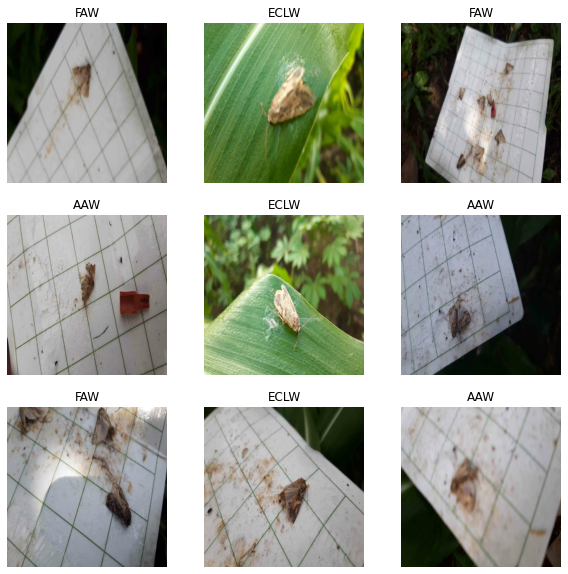

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))

for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

As we can see, in the randomly chosen images, there seem to be quite some variation with our data set.

## Preparing Data Set for Modelling

One of the major differences between traditional machine learning techniques/algorithms (such as k-NN) and representation machine learning technique/algorithms (such as deep learning or neural networks) is that with deep learning algorithms, there's almost no need to hand-engineer features to prepare them for your neural network/model. What is mostly needed in the data set preparation stage is to configure the data set so we can get optimal training performance during runtime, and as well standardize the dataset (or perform what is called "input normalization".



### Data Set Configuration

While data set configuration are not standard practices in deep learning and are specific to frameworks (such as TensorFlow), it is always good practice to configure our dataset for performance both on the side of compuation and that of training by our neural network.

Let's make sure to use buffered prefetching so you can yield data from disk without having I/O become blocking. The two data configuration methods we used when loading data from disk to our neural network include;

`Dataset.cache()` which keeps the images in memory (RAM) after they're loaded off disk during the first epoch. This will ensure our dataset does not become a bottleneck while training the model.


### Data Set Transformation

The data set transformation method we used for our dataset is provided through the `tf.data` API in TensorFlow.

`Dataset.prefetch()` overlaps data preprocessing and model execution while training.


Prefetching overlaps the preprocessing and model execution of a training step. While the model is executing training `step s`, the input pipeline is reading the data for `step s+1`. Doing so reduces the step time to the maximum (as opposed to the sum) of the training and the time it takes to extract the data.

We used this transformation process to decouple the time when data is produced from the time when data is consumed. In particular, it uses a background thread and an internal buffer to prefetch elements from the input dataset ahead of the time they are requested.

We set the `buffer_size` (the number of elements to prefetch which should be equal to or greater than our chosen `batch_size`) automatically to `tf.data.experimental.AUTOTUNE` which will prompt the `tf.data` runtime to tune the value dynamically at runtime.


### Data Set Normalization

Since our training data is just image data with pixel values between 0 and 255 which represents ths intensity of each of the channels for an image. And to make sure we do not run into any gradient problems (for example, getting stuck in local optima) while our model is learning (because of the size of the data points for each of the images), the pixel values have been scaled between 0 and 1 [0, 1] in a process known as data normalization (or standardization).

We standardized the pixel values for our image data set to be in the [0, 1] range by using a `Rescaling` layer that is found in TensorFlow.

In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [ ]:
normalization_layer = layers.experimental.preprocessing.Rescaling(1./255)

In [ ]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixels values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image)) 

0.0 0.96536547


## Model Building

### Why CNN Will Be Useful for Our Task

There are four main ingredients we need to put together our own neural network
and deep learning algorithm: a dataset, a model/architecture, a loss function, and an optimization method.

The use of CNNs give us two key benefits; 

1. Local invariance,

2. and compositionality.

**Local Invariance:** The concept of local invariance allows us to classify an image in our data set as containing a particular species of moth regardless of where in the image the moth (either FAW, AAW, or ECLW) appears. We obtain this local invariance through the usage of "pooling layers” which identifies regions of our input volume (our image with 3 color channels) with a high response to a particular filter.

**Compositionality:** Compositionality is the concept of building higher-level features from lower-level ones. For example, our network may build edges from
pixels, shapes from edges, and then complex objects from shapes – all in an automated fashion that happens naturally during the training process. In fact, this concept is exactly why CNNs are so powerful and would be very useful for our work in classifying moth species.

Unlike a standard neural
network, layers of a CNN are arranged in a 3D volume in three dimensions: width, height, and
depth (where depth refers to the third dimension of the volume, such as the number of channels in
an image or the number of filters in a layer).

### Defining The Model Architecture for a Custom Convountional Neural Network (Built From Scratch).

Choosing the right architecture for our model is part art and part science. And while choosing our network architecture, we took into account the following;

1. How many data points you have.
2. The number of classes.
3. How similar/dissimilar the classes are.
4. The intra-class variance.



#### How We Came Up With the MothNet Architecture: Architecture Documentation


The following layers make up any CNN architecture because they have a substantial impact on the spatial dimensions of an image as it moves through a CNN;

- Convolutional Layer (`CONV`),

- Pooling Layer (`POOL`),

- Activation Layer (or `RELU`),

- Fully Connected Layer (or `FC`).



**Some Few Thinsgs You Should Know**

**Kernel/Filter:** A kernel can be visualized as a small matrix that slides across, from left-to-right and
top-to-bottom, of a larger image. At each pixel in the input image, the neighborhood of the image
is convolved with the kernel and the output stored.

`CONV` and `FC`, (and to a lesser extent, `BN`) are the only layers that contain
parameters that are learned during the training process.

We define our model architecture using Keras' `Sequential()` API. This allows us to customize our model's input, convolutional layer (a combination of the `CONV` and `POOL` layers), as well as our dense layer (our `FC` or "fully connected" layer).

We are also using the `'relu'` (or Rectified Linear Unit) activation function because it is the most common choice for working with images as it works well and is computationally efficient.

Activation and dropout layers are not considered true “layers" themselves, but are often included in network diagrams (as you will see in the graph below) to make the architecture explicitly clear.




As you can see below, we follow the defined architecture above, but a

`layer.Conv2D()` --> This method lets us define the convultional layer and operators, taking in input data.

`layer.MaxPooling2D()` --> This method lets us define the max pooling layer and operates on the output of their preceeding convolutional layer by scaling down the output of the convolutional layers, by keeping only the largest value and throwing away the smaller ones. This makes the neural network more efficient by getting rid of least useful data and only using the most useful data.


`layer.Flatten()` is a useful layer in our neural network because when transitioning from a convolitional layer to a fully connected layer, we need to tell Keras that we are no longer working with 2-D images. There are no parameters required for `layer.Flatten()`.

`layer.Dense()` --> This method lets us define the fully connected layer for our network.

The activation function in the output layer is a `'softmax'` activation function. It is the most common activation function for multi-class classification problems (with more than one output class). It is a special function that makes sure all the output values from the final fully connected (or dense) layer add up to exactly 1; which is the likelihood that an image is a Fall Army Worm (FAW) compared to an Egyptian Cotton Leave Worm (ECLW) or an African Army Worm (AAW).

`model.compile()` --> Tells Keras that we are done defining the model and that we actually want to build it out in memory.

We compiled our model with the following hyperparameters;

`optmizer = 'adam'` --> We chose the `'adam'` (or Adaptive Moment Estimation) variant of mini-batch gradient descent as our optmization algorithm. It usually not necessary to do learning rate decay with Adam optimizer, so in our experiment, we will start without setting a specific learning rate for the optimizer or using a learning rate scheduler. We are using Adam as a default in our experiment because can converge faster than other optimizers in certain situations.

> The optimization algo controls how the model will update the model's weights to reduce the loss.

`loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)` --> Since this is a multi-class problem, we measure loss (error) with the `categorical crossentropy` loss. This loss function is used because it handles calculating the loss across all possible classes and it also determines the highest predicted class, and calculates loss based on how often this is the correct class.


`metrics=METRICS` -->  In this case we use accuracy, that is how often the images are correctly classified. Higher is better. Also, the classes in our data are fairly balanced across the entire dataset so accuracy seems like a good metric for tracking the performance. But just to clear all assumptions (that the dataset may not be balanced enough for a concerete measurement with accuracy), we will also;
- calculate and plot the confusion matrix (false negatives, false positives, true negatives, true positives) and perform error analysis during evaluation.

- calculate and plot precision, recall, and AUC of the model.


**Understanding the metrics used**



*   **True** negatives and **true** positives are  moth classes that were **correctly** classified.
*   **False** negatives and **false** positives are moth classes that were **incorrectly** classified.
*   **Accuracy** is the percentage of moth images correctly classified
>   $\frac{\text{true moth classes}}{\text{total number of moth classes}}$
*   **Precision** is the percentage of **predicted** positives that were correctly classified.
>   $\frac{\text{model correctly predicts the target moth class}}{\text{model correctly predicts the target moth class + model incorrectly predicts the target moth class as another class.}}$
*   **Recall** is the percentage of **actual** positives that were correctly classified
>   $\frac{\text{model correctly predicts the target moth class}}{\text{model correctly predicts the target moth class + model incorrectly predicts the non-target moth class}}$
*   **AUC** refers to the Area Under the Curve of a Receiver Operating Characteristic curve (ROC-AUC). This metric is equal to the probability that a classifier will rank a random positive target moth class higher than a random negatice target moth class.


In [ ]:
num_classes = 3

METRICS = [
      tf.keras.metrics.TruePositives(name='tp'),
      tf.keras.metrics.FalsePositives(name='fp'),
      tf.keras.metrics.TrueNegatives(name='tn'),
      tf.keras.metrics.FalseNegatives(name='fn'), 
      tf.keras.metrics.BinaryAccuracy(name='accuracy'),
      tf.keras.metrics.Precision(name='precision'),
      tf.keras.metrics.Recall(name='recall'),
      tf.keras.metrics.AUC(name='auc'),
]

def create_model():
  '''
  Define model architecture with Sequential API.

  Return: Compiled model.
  
  '''
  model = Sequential([
    layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height,\
                                                                     img_width, 3)),
                                                                
    layers.Conv2D(16, 3, padding='same', activation='relu', name="conv2d_2"),
    layers.MaxPooling2D(),
    layers.Conv2D(32, 3, padding='same', activation='relu', name="conv2d_3"),
    layers.MaxPooling2D(),
    layers.Conv2D(64, 3, padding='same', activation='relu', name="conv2d_4"),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(num_classes)
  ])

  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=METRICS)

  return model

time: 48.9 ms (started: 2021-02-04 09:59:53 +00:00)


In [ ]:
# Create a basic model instance
model = create_model()

When we are building any type of neural network architecture at all, it is helpful to print out all layers in the defined CNN architecture and their parameters.



In [ ]:
# Display the model's architecture
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling_1 (Rescaling)      (None, 500, 500, 3)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 500, 500, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 250, 250, 16)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 250, 250, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 125, 125, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 125, 125, 64)      18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 62, 62, 64)        0

### Visualising Our Neural Network Architecture

We typically use network architecture visualization when;

1. Debugging our own custom network architectures and

2. Publication, where a visualization of the architecture is easier to
understand than including the actual source code or trying to construct a table to convey the same information. (Source: rosebrock_dl4cv, Pg. 271 [Deep Learning for Computer Vision with Python](https://www.pyimagesearch.com/deep-learning-computer-vision-python-book/#:~:text=Deep%20Learning%20for%20Computer%20Vision%20with%20Python%20will%20make%20you,Convolutional%20Neural%20Networks%20(CNNs)).)

Visualising our neural network architecture can help us alliviate the most common flaws in building or using a CNN architecture, which includes:
1. Incorrectly ordering layers in the network.
2. Assuming an (incorrect) output volume size after a CONV (convolutional) or POOL (pooling) layer.

Whenever implementing a network architecture, it is suggested that we visualize the network architecture after every block of CONV and POOL layers, which will enable us to validate your assumptions (and more importantly, catch “bugs” in the network early on). (Source: rosebrock_dl4cv, Pg. 272 [Deep Learning for Computer Vision with Python](https://www.pyimagesearch.com/deep-learning-computer-vision-python-book/#:~:text=Deep%20Learning%20for%20Computer%20Vision%20with%20Python%20will%20make%20you,Convolutional%20Neural%20Networks%20(CNNs)).)





### Graphical Visualization

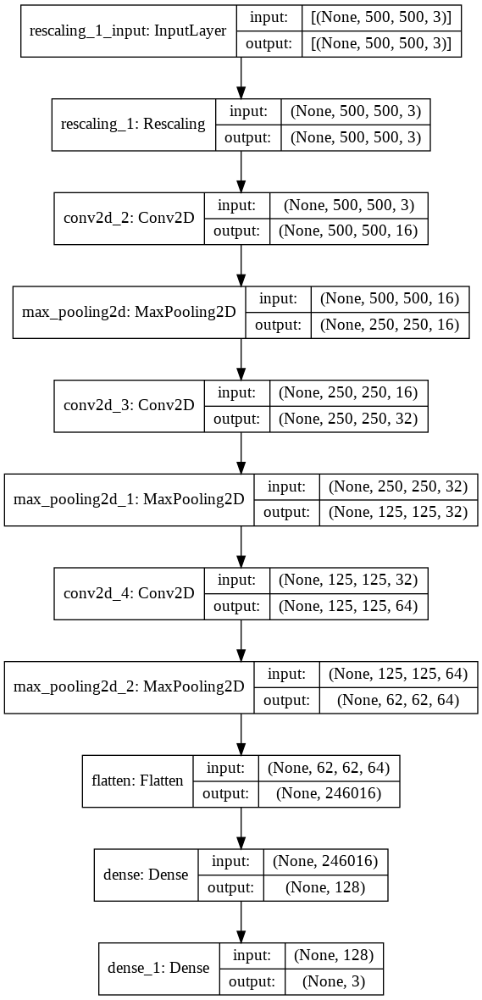

In [ ]:
plot_model(model, to_file="mothnet.png", show_shapes=True)

A graphical depiction of the MothNet network architecture generated by Keras.
Each node in the graph represents a specific layer function (i.e., convolution, pooling, activation,
flattening, fully-connected, etc.). Arrows represent the flow of data through the network. Each node
also includes the volume input size and output size after a given operation.




### Understanding the Graphviz of MothNet Architecture



`InputLayer`

Walking through the MothNet architecture, we see the first layer is our `InputLayer` which accepts
a 500X500X3 input image (which represents 500 px in height, 500 in width, and 3 in depth based on the number of color channels; RGB). 

The spatial dimensions for the input and output of the layer are the same
as this is simply a “placeholder” for the input data.
You might be wondering what the `None` represents in the data shape (None, 400, 712, 3). The `None` is actually our batch size. When visualizing the network architecture, Keras does not
know our intended batch size so it leaves the value as None. When training this value would change
to 20 (because we set the `batch_size` earlier to be 20).


`Rescaling Layer`

The next layer is the Rescaling layer we prepared earlier to scale our image data between 0 and 1 `[0, 1]` for neural network efficiency during training (as our neural network peforms well when input data is scaled between 0 and 1). The spatial dimensions for our data remains the same at 400x712x3 as normalization only affects the actual values of the image pixels, not their height or width.


`conv2d: Conv2D`

Next, our data flows to the first CONV layer, where we learn 32 kernels on the 400x712x3 input.

The output of this first CONV layer is 400x712x32. We have retained our original spatial dimensions due to zero padding (`padding='same'`), but by learning 32 filters (or kernels), we have changed the volume size (or depth size). Zero padding is best for efficiency.

`conv2d_1: Conv2D`

The output of the first CONV layer is fed into the input of the second CONV layer (`conv2d_1`). Here we keep all hyperparameter values from the previous CONV layer the same except that apply `padding='valid'` as the `padding` hyperparameter. Since valid padding follows this formula (syntax in Python);

```python

out_height = ceil(float(image_height - filter_height + 1) / float(strides[1]))
out_width  = ceil(float(image_width - filter_width + 1) / float(strides[2]))

```


The above code stores the weights to a collection of checkpoint-formatted files that contain only the trained weights in a binary format. Checkpoints contain:

- One or more shards that contain your model's weights.

- An index file that indicates which weights are stored in which shard.

Training was monitored using TensorBoard, TensorFlow’s visualization toolkit. TensorBoard is often used by researchers and engineers to visualize their ML models, monitor the performance of their models, and understand their ML experiments.  


With TensorBoard we will;
- Visualize the metrics of our model,
- Visualize a version of the confusion matrix plot,
- Compare traning and evaluation metrics; ops (operations), DAGs (diacyclic graphs), and layers (the ones we defined for the model),
- Visualize our model graph,
- View histograms of weights, biases, and other tensors as they change over time.

Training was profiled at execution using TensorFlow's profiler to track traininf perfomrance and debug errors after each experiment.

In [ ]:
 # Load the TensorBoard notebook extension.
%load_ext tensorboard

In [ ]:
# To manually time how long each cell runs (from this cell)
%load_ext autotime 

time: 115 µs (started: 2021-02-04 09:59:44 +00:00)


TensorFlow and TensorBoard communicate using files which are written by TensorFlow during training and contain the latest performance statistics for that training run. TensorBoard reads those statistics from the logs written by TensorFlow and uses them to construct displays that we can visualize.


We chose not to use an **earlystopping callback** because our model's training isn't intensive and does not take up too much compute power--this is, of course, because of our limited training data.


We used the `tf.keras.callbacks.ModelCheckpoint` callback because we might encounter a scenario where our model may train for a long-time and because our compute hardware is both limited and volatile, we want to make sure model training picks up where it left off--especially in a case the training process was interrupted. The `tf.keras.callbacks.ModelCheckpoint` callback allows us to continually save the model both during and at the end of training.

In [ ]:
# Change your directory to Uniport AI drive dir
!ls #{Change directory here and delete when you commit to GitHub}

In [ ]:
# Folder path to the log files that will contain training statistics
logger = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logger,
                                                 histogram_freq = 1, # Training stats will be written every epoch
                                                 write_graph=True,
                                                 profile_batch = '500,520') # Profiling all our batches (From 0 to 20)

checkpoint_path = "training{}/cp-{epoch:04d}.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                   save_weights_only=True,
                                   verbose=1)

In [ ]:
# Train the model, specifying the callbacks
epochs = 20


# We add to the fit method the validation/test data.  This will cause the training model 
# to evaluate itself on the validation/test data on each epoch.  This provides per 
# epoch data points TensorBoard can plot so we can see the trend.

history = model.fit(
  train_ds,
  validation_data=val_ds,
  shuffle=True,
  epochs=epochs,
  callbacks=[cp_callback, tboard_callback] # Pass callbacks to training
)

In [ ]:
# looking at the resulting checkpoints...
!ls {checkpoint_path}

Before launching TensorBoard, we might have to kill previous training instance using the `!kill {instance id}` command instead.

In [ ]:
# Launch TensorBoard with objects in the log directory

%tensorboard --logdir=logs 

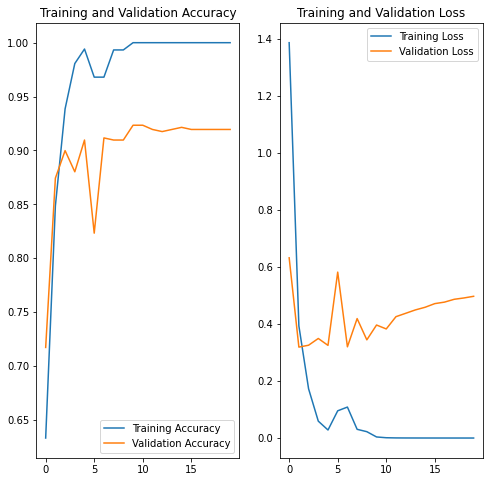

time: 281 ms (started: 2020-12-28 15:15:50 +00:00)


In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
# Print result for all metrics
baseline_results = restored_model.evaluate(val_ds, verbose=0)

for name, value in zip(model.metrics_names, baseline_results):
  print(name, ': ', value)
print()

### Visualizing Intermediate Representations

In [ ]:
# Directory with our AAW pictures
data_dir_aaw = os.path.join('/content/drive/MyDrive/UNIPORT AI PROJECT/moth_data/AAW')

# Directory with our FAW pictures
data_dir_faw = os.path.join('/content/drive/MyDrive/UNIPORT AI PROJECT/moth_data/FAW')

# Directory with our ECLW pictures
data_dir_eclw = os.path.join('/content/drive/MyDrive/UNIPORT AI PROJECT/moth_data/ECLW')


# Now, let's see what the filenames look like in the horses and humans training directories:

aaw_imgs = os.listdir(data_dir_aaw)
print(aaw_imgs[:10])

faw_imgs = os.listdir(data_dir_faw)
print(faw_imgs[:10])

eclw_imgs = os.listdir(data_dir_eclw)
print(eclw_imgs[:10])

['AAW-000.jpg', 'AAW-001.jpg', 'AAW-003.jpg', 'AAW-002.jpg', 'AAW-005.jpg', 'AAW-004.jpg', 'AAW-007.jpg', 'AAW-006.jpg', 'AAW-008.jpg', 'AAW-009.jpg']
['FAW-000.jpg', 'FAW-001.jpg', 'FAW-0068.jpg', 'FAW-0045.jpg', 'FAW-00182.jpg', 'FAW-00455.jpg', 'FAW-00318.jpg', 'FAW-00469.jpg', 'FAW-00482.jpg', 'FAW-0016.jpg']
['ECLW-000.jpg', 'ECLW-001.jpg', 'ECLW-002.jpg', 'ECLW-003.jpg', 'ECLW-005.jpg', 'ECLW-004.jpg', 'ECLW-006.jpg', 'ECLW-007.jpg', 'ECLW-008.jpg', 'ECLW-009.jpg']
time: 27.6 ms (started: 2020-12-28 15:16:15 +00:00)


In [ ]:
img_path = os.path.join('/content/drive/MyDrive/UNIPORT AI PROJECT/moth_data/ECLW/ECLW-000.jpg')

# We preprocess the image into a 4D tensor
img = tf.keras.preprocessing.image.load_img(img_path, target_size=(500, 500))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)

(1, 500, 500, 3)
time: 127 ms (started: 2020-12-28 15:21:09 +00:00)


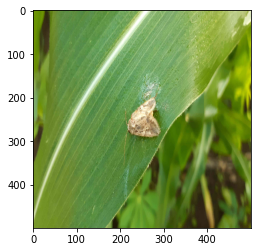

time: 185 ms (started: 2020-12-28 15:21:17 +00:00)


In [ ]:
plt.imshow(img_tensor[0])
plt.show()

In [ ]:
# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[1:]]
# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)

time: 7.75 ms (started: 2020-12-28 15:21:25 +00:00)


In [ ]:
# This will return a list of 5 Numpy arrays:
# one array per layer activation
activations = activation_model.predict(img_tensor)

time: 281 ms (started: 2020-12-28 15:21:27 +00:00)


In [ ]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 500, 500, 16)
time: 943 µs (started: 2020-12-28 15:21:28 +00:00)


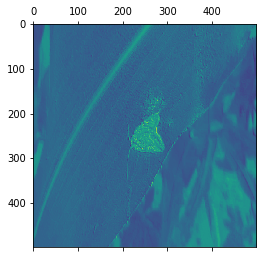

time: 134 ms (started: 2020-12-28 15:21:28 +00:00)


In [ ]:
plt.matshow(first_layer_activation[0, :, :, 3], cmap='viridis')
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:28: RuntimeWarning: invalid value encountered in true_divide


MemoryError: ignored

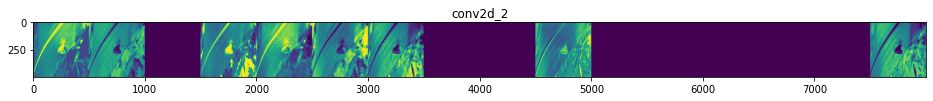

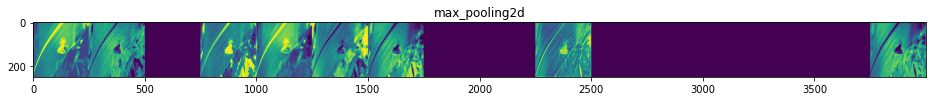

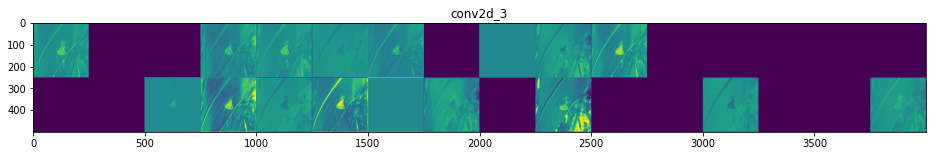

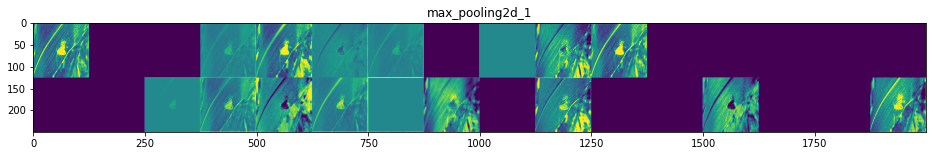

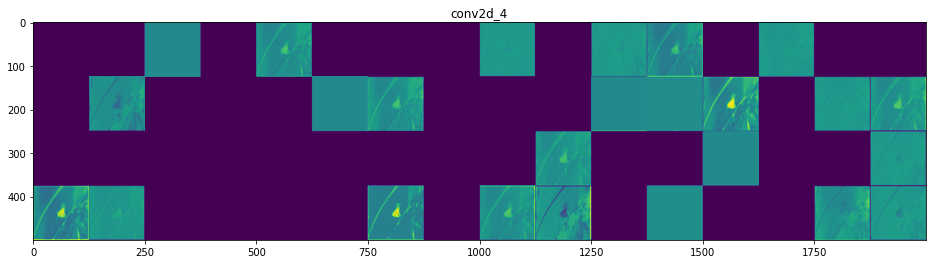

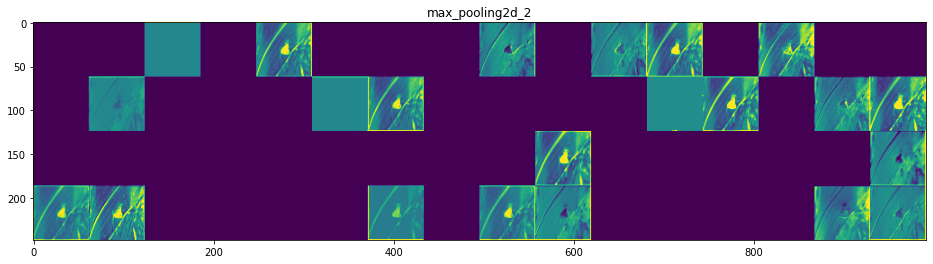

time: 2.48 s (started: 2020-12-28 15:21:55 +00:00)


In [ ]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
for layer in model.layers[1:]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

### Uploading Our Experiment To TensorBoard.dev

Tensorboard.dev is a way to easily host, track, and share your ML experiments for free. It is a managed TensorBoard experience that lets you upload and share your ML experiment results with anyone. We simply upload our TensorBoard logs and receive a link that can be viewed by everyone, with no installation or setup.

In [ ]:
!tensorboard dev upload --logdir ./logs \
  --name "Custom CNN MothNet With Diff. Sizes (SECOND TRY)" \
  --description " Behnchmark Training results from building custom CNN using dims (500, 500)" \
  --one_shot

2020-12-28 15:22:34.329846: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) y

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scop

In [ ]:
# For when we want to delete and clean up our TensorBoard environment

# You must replace YOUR_EXPERIMENT_ID with the value output from the previous
# tensorboard `list` command or `upload` command.  For example
# `tensorboard dev delete --experiment_id pQpJNh00RG2Lf1zOe9BrQA`

# !tensorboard dev delete --experiment_id yE7evqw4QrGn3ya8hLi3Gw

2020-12-16 11:33:45.599496: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Deleted experiment yE7evqw4QrGn3ya8hLi3Gw.


### Adding Dropout and Data Augumentation To Improve The System

It turns out the system was overfitting with our custom (MothNet) CNN. Using different dimensions at (300, 300) and (500, 500). The report can be found below;

**Description:** Training results from building custom CNN using dimensions (500, 500). The live result can be found [here](https://tensorboard.dev/experiment/eYGHZEUbTqac2VGazclBmA/#scalars).

![Loss and Accuracy using a (500, 500)](https://cdn.hashnode.com/res/hashnode/image/upload/v1612424461617/PWdBjyS_D.png)

**Description:** Training results from building custom CNN using dimensions (300, 300) and (500, 500) can be found [here](https://tensorboard.dev/experiment/LzmqntD7TRy1N2OnyPOEWQ/#scalars).

![Loss and Accuracy using a (300, 300) and (500, 500) dimension](https://cdn.hashnode.com/res/hashnode/image/upload/v1612424461617/PWdBjyS_D.png)

We can see that our system overfits on a shallow CNN architecture. To combat this, we added a drop out layer (with a probability of 0.2) to the architecture and also augument our dataset.

In essence, the forms of refularization we are using on our model are to;
1. Modify the network architecture itself using a drop-out using a probability of `0.5`. 
2. Augment the image data passed into the network for training.



**Data Augmentation.**

Augmenting our image data will help us avoid overfitting our training data since we have a limited data set. Our data set does not account for all future predictions or occurences so we typically try to augument our dataset to look more like these scenraios.

For example, we might augment our system to rotate an image of the moth so we can have a flipped image in our training set and when the image is working on the farm, when it sees an horizontal insect picture, it should be able to classify it.

Augmentation simply amends our images on-the-fly while training using transforms like rotations. So, it could "simulate" an image of Fall Army Warm upside down, so we it will be easy for our system to classify an upside-down (or 90 degree rotated image) image or video of a Fall Army Warm in the farm.

Data augmentation with `tf.keras` does in-memory pre-processing of the image data as it's performing the training, allowing us to experiment without impacting our dataset. `ImageDataGenerator` from `tf.keras` lets us augment your images in real-time while your model is still training. We can apply any random transformations on each training image from our dataset as it is passed to the model. This will not only make our model robust but will also save us on the overhead memory.

To come up with the right transforms, we thought of the various scenarios our system could encounter the moth (both on and away from the farm);

**Random rotations:** `(parameter: rotation_range)` Our system might encounter scenarios where the moth species may be flying into the farm in an awkward way, perhaps flying at a different angle than normal. With random rotations, we can ensure that our model is invariant to the rotation of the object.

**Random shifts:** `(parameters: width_shift_range and height_shift_range=0.0)` Most of the pictures we took of our images have the moth at the center of the images. This is of course not always be the case when the system will operate on the farmland. We may have the moth flying in from left to right or top to bottom across the camera. We can go our model be robust enough to still accurately classify the moth by performing some random shifts on our training data.

**Random flips:** `(parameters: horizontal_flip=True and vertical_flip=True)` Because our moth is symmetric in physiology, it makes sense that we could do we flips vertically and horizontally to aid the robustness of our model.

**Random brightness:** `(parameter: brightness_range)` Most of the time our moth will not be under perfect lighting condition. So, it becomes imperative to train our model on images under different lighting conditions.

**Random zoom:** `(parameter: zoom_range)` Our moth object might sometimes be very close to the camera and also far away from the camera. We therefore need to augment  randomly zooms in on the image or zooms out of the image so it simulates far and near distance of our target object.





In [ ]:
#########################################
# Adjust as follows;
# rotation: 0.1
# Take away contrast.
# Reduce translation factor to 0.1
# reduce zoom factor to 0.1
#########################################

data_augmentation = tf.keras.Sequential([
  layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
  layers.experimental.preprocessing.RandomRotation(0.2),
  layers.experimental.preprocessing.RandomContrast([0.6, 0.8]),
  layers.experimental.preprocessing.RandomTranslation(height_factor=0.3, 
                                                      width_factor=0.3, 
                                                      fill_mode='nearest',
                                                      interpolation='nearest'),
  layers.experimental.preprocessing.RandomZoom(0.2, width_factor=None, 
                                               fill_mode='nearest',
                                               interpolation='nearest')
  
])

In [ ]:
data_augmentation = keras.Sequential(
  [
    layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical", 
                                                 input_shape=(img_height, 
                                                              img_width,
                                                              3)),
    layers.experimental.preprocessing.RandomRotation(0.1),
    layers.experimental.preprocessing.RandomZoom(0.1),
  ]
)

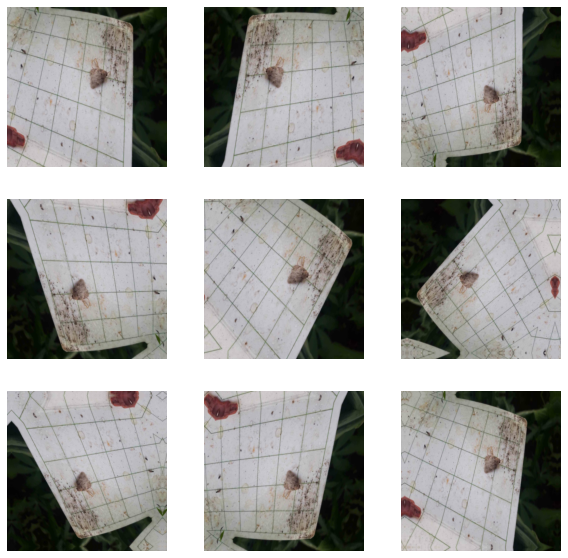

In [ ]:
for image, _ in train_ds.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

We will now take the data augmentation `Sequential` layers we created earlier and add it to our original architecture to see if we will be able to improve our classifier by any bit.

The `Sequential()` API for keras supports adding our data augumentation techniques defined as layers since they were also created using the same API, we can naturally define transformations in the actual architecture but to keep things simple, we defined it separately and added it as the `data_augmentation` layer (rughtly the first layer in the network since it transforms the images in-memory, while the model trains).


Why we added `layer.Dropout()`? --> The purpose of drop-out in our CNN is to prevent the overfitting scenario we spotted in our model earlier. The effect of adding the random dropout is that the function forces our network to learn less redundant representations of our image dataset--making it moe robust. We added this layer between the `MaxPooling2D` layer and the `Flatten` layer so that only relevant feature maps are learned and flattened. We used a probability of 0.5 (meaning 50% of the learnable parameters are dropped) because it is a common starting choice and we can always tune it if we notice it is having a larger-than-expected effect on the model's training performance.

In [ ]:
def create_model():
  '''
  Define model architecture with Sequential API and data augumentation layers.

  Return: Compiled model.
  
  '''
  num_classes = 3
  
  model = Sequential([
    data_augmentation,
    layers.experimental.preprocessing.Rescaling(1./255, input_shape=(img_height,\
                                                                     img_width, 3)),
                                                                
    layers.Conv2D(16, 3, padding='same', activation='relu', name="conv2d_2"),
    layers.MaxPooling2D(),
    layers.Conv2D(32, 3, padding='same', activation='relu', name="conv2d_3"),
    layers.MaxPooling2D(),
    layers.Conv2D(64, 3, padding='same', activation='relu', name="conv2d_4"),
    layers.MaxPooling2D(),
    layers.Dropout(0.5),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(num_classes)
  ])

  model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=METRICS) # We defined metrics in a previous cell.

  return model

time: 12.4 ms (started: 2021-01-03 14:42:46 +00:00)


In [ ]:
model = create_model()

time: 170 ms (started: 2021-01-03 14:42:46 +00:00)


In [ ]:
# Load the tensorboard extension
% reload_ext tensorboard

In [ ]:
# Clear any logs from previous runs
!rm -rf ./logs/

In [ ]:
logger = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logger,
                                                 histogram_freq = 1,
                                                 write_graph=True,
                                                 profile_batch = '0, 20') # Profiling all our batches (From 0 to 20)

checkpoint_path = "training/cp-{epoch:04d}.ckpt"
cp_with_data_aug = os.path.dirname(checkpoint_path)


# Create a callback that saves the model's weights only during training
cp_callback_data_aug = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                   save_weights_only=True)

# Creates custom writer for confusion matrix result
file_writer_cm = tf.summary.create_file_writer(logger + '/cm')                                   

time: 7.09 ms (started: 2021-01-03 14:42:49 +00:00)


#### Writing The Confusion Matrix to TensorBoard

Since we can view most of our metrics in TensorBoard, it will be nice to have our confusion matrix result/figure nicely formated there as well--we have to do this before training is called as we will need to pass the custom writer as a callback during training. 


In [ ]:
import itertools

In [ ]:
def plot_confusion_matrix_tb(cm, class_names):
    """
    Returns a matplotlib figure containing the plotted confusion matrix.
    
    Args:
       cm (array, shape = [n, n]): a confusion matrix of integer classes.
       class_names (array, shape = [n]): String names of the integer classes.
    
    Returns:
       Matplotlib figure containing the plotted confusion matrix.
    """
    
    figure = plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion matrix")
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)
    
    # Normalize the confusion matrix.
    cm = np.around(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis], decimals=2)
    
    # Use white text if squares are dark; otherwise black.
    threshold = cm.max() / 2.
    
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        color = "white" if cm[i, j] > threshold else "black"
        plt.text(j, i, cm[i, j], horizontalalignment="center", color=color)
        
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    return figure


Unfortunately, the Matplotlib file format cannot be logged as an image, but the PNG file format can be logged. So we create a helper function that takes a Matplotlib figure and converts it to PNG format so it can be written.

In [ ]:
def plot_to_image(figure):
    """Converts the matplotlib plot specified by 'figure' to a PNG image and
    returns it. The supplied figure is closed and inaccessible after this call.

    Args:
        figure: Matplotlib plot.
      
    Returns:
        image: PNG image of the Matplotlib plot.
    """
    
    buf = io.BytesIO()
    
    # Use plt.savefig to save the plot to a PNG in memory.
    plt.savefig(buf, format='png')
    
    # Closing the figure prevents it from being displayed directly inside
    # the notebook.
    plt.close(figure)
    buf.seek(0)
    
    # Use tf.image.decode_png to convert the PNG buffer
    # to a TF image. Make sure you use 4 channels.
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    
    # Use tf.expand_dims to add the batch dimension
    image = tf.expand_dims(image, 0)
    
    return image

In [ ]:
def log_confusion_matrix(epoch, logs):
    
    # Use the model to predict the values from the test_images.
    y_pred = new_model.predict(val_ds)
    
    predicted_categories = tf.argmax(y_pred, axis=1)

    true_categories = tf.concat([y for x, y in val_ds], axis=0)
    
    # Calculate the confusion matrix using sklearn.metrics
    cm = sklearn.metrics.confusion_matrix(predicted_categories, true_categories)
    
    figure = plot_confusion_matrix_tb(cm, class_names=class_names)
    cm_image = plot_to_image(figure)
    
    # Log the confusion matrix as an image summary.
    with file_writer_cm.as_default():
        tf.summary.image("Confusion Matrix", cm_image, step=epoch)

# Define the per-epoch callback.
cm_callback = tf.keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix)

In [ ]:
# Launch TensorBoard with objects in the log directory
!kill 
%tensorboard --logdir=logs

In [ ]:
# Train the model, specifying the callback
epochs = 20
history = model.fit(
  train_ds,
  validation_data=val_ds,
  shuffle=True,
  epochs=epochs,
  callbacks=[cp_callback_data_aug, tboard_callback, cm_callback])

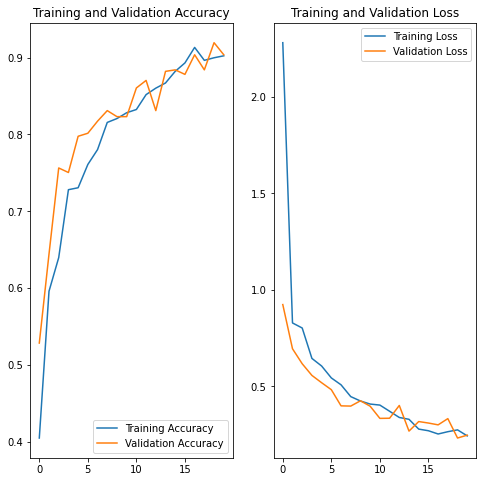

time: 298 ms (started: 2021-01-03 14:49:43 +00:00)


In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

### Evaluating Our Model

In [ ]:
loss, acc = model.evaluate(val_ds, verbose=2)

# Print model accuracy
print("Trained model, accuracy: {:5.2f}%".format(100 * acc))

# Print model loss
print("Trained model, loss: {:5.2f}%".format(100 * loss))

26/26 - 1s - loss: 0.2472 - accuracy: 0.9037
Trained model, accuracy: 90.37%
Trained model, loss: 24.72%
time: 782 ms (started: 2021-01-03 14:53:52 +00:00)


Evaluate the model's performance using;

- its loss,
- area under curve,
- precision,
- and recall.


In [ ]:
# Print result for all metrics

baseline_results = model.evaluate(val_ds, verbose=0)

for name, value in zip(model.metrics_names, baseline_results):
  print(name, ': ', value)
print()

In [ ]:
def plot_metrics(history):
  metrics = ['loss', 'auc', 'precision', 'recall']
  for n, metric in enumerate(metrics):
    name = metric.replace("_"," ").capitalize()
    plt.subplot(2,2,n+1)
    plt.plot(history.epoch, history.history[metric], color=colors[0], label='Train')
    plt.plot(history.epoch, history.history['val_'+metric],
             color=colors[0], linestyle="--", label='Val')
    plt.xlabel('Epoch')
    plt.ylabel(name)
    if metric == 'loss':
      plt.ylim([0, plt.ylim()[1]])
    elif metric == 'auc':
      plt.ylim([0.8,1])
    else:
      plt.ylim([0,1])

    plt.legend()

#### Confusion Matrix

In [ ]:
y_pred = new_model.predict(val_ds)

In [ ]:
predicted_categories = tf.argmax(y_pred, axis=1)

In [ ]:
true_categories = tf.concat([y for x, y in val_ds], axis=0)

In [ ]:
cm = sklearn.metrics.confusion_matrix(predicted_categories, true_categories)

In [ ]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """Prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.

    Args:
        cm (array, shape = [n, n]): confusion matrix of integer classes.
        classes (array, shape = [n]): String names of the integer classes.
    
    Returns:
        Print the confusion matrix and return the Matplotlib plot of the confusion matrix.

    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix.")
    else:
        print('Confusion matrix, without normalization.')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Confusion matrix, without normalization
[[124   4   3]
 [  5 175  31]
 [  1   5 161]]


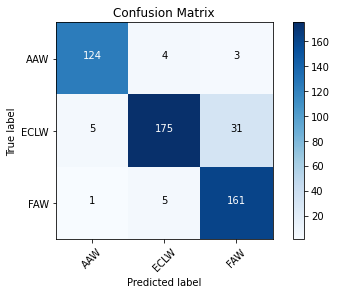

In [ ]:
plot_confusion_matrix(cm=cm, classes=class_names, title='Confusion Matrix')

#### Reading The Confusion Matrix


Looking at the plot of the confusion matrix, we have the predicted labels ('Predicted Label') on the x-axis and the true labels ('True Label') on the y-axis. The blue cells running from the top left to bottom right contain the number of samples that the model accurately predicted. The white cells contain the number of samples that were incorrectly predicted.

There are 509 total samples in the test set. Looking at the confusion matrix, we can see that the model accurately predicted 460 out of 509 total samples. The model incorrectly predicted 49 out of the 509.

### Error Analysis

In [ ]:
#Retrieve a batch of images from the test set
image_batch, label_batch = val_ds.as_numpy_iterator().next()

In [ ]:
def view_true_vs_pred(y_pred, predicted_categories, image_batch, 
                      true_categories, batch_size):
    """Print predcited classes and categories and plot classified and 
       misclassified classes.

      Args:
          y_pred (list): list of lists of predicted classes.
          pred_categories (list): class of 3 classes model predicted with highest 
                                  confidence.
          image_batch (numpy.ndarray): Array of validation images.
          true_categories (tensor): Array of ground truth labels.
          batch_size (int): Number of batches of images.
      
      Returns:
          Printed lists of; model predictions and labels.
          Plot of correctly classified (green label) and misclassified images 
          (red label).
    """
    print('Predictions:\n', y_pred)
    print('Labels:\n', predicted_categories.numpy())

    x = np.ceil(np.sqrt(batch_size))
    y = np.ceil(batch_size / x)
    fig = plt.figure(figsize=(x * 6, y * 7))

    for i, (image, label, prediction) in enumerate(zip(image_batch, 
                                                      true_categories, 
                                                      predicted_categories)):
      # Render the image
      ax = fig.add_subplot(x, y, i+1)
      ax.imshow(image.astype("uint8"), aspect='auto')
      ax.grid(False)
      ax.set_xticks([])
      ax.set_yticks([])

      # Display the label and optionally prediction
      x_label = 'Label: ' + class_names[label]
      if prediction is not None:
        x_label = 'Prediction: ' + class_names[predicted_categories[i]] + '\n' + x_label
        ax.xaxis.label.set_color('green' if class_names[true_categories[i]] == \
                                class_names[predicted_categories[i]] else 'red')
      ax.set_xlabel(x_label, fontsize = 25, fontweight ='bold')

    plt.show()

Predictions:
 [[ -1.3117998    5.752758    -1.0023069 ]
 [ -0.44648135   0.756592     6.8750644 ]
 [  8.90941     19.288488   -17.417494  ]
 ...
 [  5.891998    18.934185   -18.734549  ]
 [ -1.1230282    2.515273    -1.0251273 ]
 [  2.7691882    1.3642203   -1.8041619 ]]
Labels:
 [1 2 1 1 1 2 2 1 2 2 2 2 0 2 1 0 1 1 0 1 2 1 1 1 1 2 2 2 1 0 0 0 2 1 0 1 2
 1 2 0 0 1 1 2 0 2 2 0 1 1 0 1 1 2 1 1 1 2 2 2 1 1 2 1 1 2 2 1 1 2 1 1 0 2
 0 1 2 2 0 1 1 1 0 0 1 2 0 1 0 0 2 0 0 0 2 1 1 1 1 1 1 2 1 1 0 1 1 0 2 1 1
 1 1 0 2 0 0 2 1 2 0 0 2 1 1 2 2 1 0 2 1 1 1 2 2 0 1 0 2 2 0 2 1 2 1 1 0 0
 1 2 2 0 2 1 0 2 1 1 2 1 1 1 1 0 1 0 2 1 1 1 2 0 2 1 2 0 1 1 1 0 0 1 2 2 1
 2 1 2 1 0 1 2 2 1 2 2 1 0 0 1 1 1 1 2 1 0 1 2 2 1 2 2 2 0 2 0 0 0 1 0 0 2
 1 1 2 2 1 2 1 0 1 1 0 1 1 0 2 1 1 0 2 2 1 1 2 0 1 1 2 0 2 0 1 0 1 2 2 0 0
 1 1 1 1 1 1 1 1 2 2 1 0 1 1 2 2 1 0 0 1 1 2 2 0 1 0 0 2 2 0 0 1 2 0 0 0 1
 2 2 1 1 2 1 0 1 2 2 2 0 1 2 1 1 2 1 1 1 0 1 2 1 0 0 1 2 0 0 0 0 1 2 2 0 1
 1 1 2 1 1 1 2 2 2 2 2 1 2 0 1 1 0 1 0 1 0 0

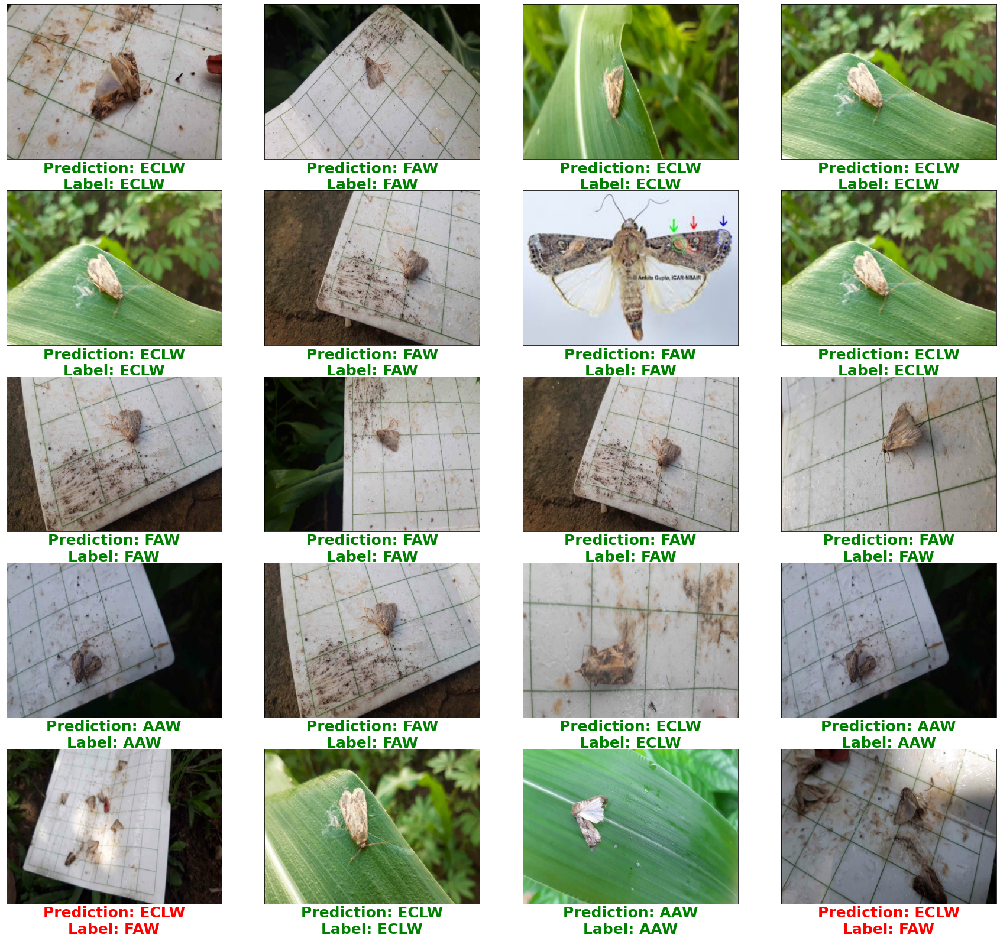

In [ ]:
view_true_vs_pred(y_pred, predicted_categories, image_batch, 
                      true_categories, batch_size)

### Saving Our Model

When we have a model that is getting good results, we want to save and share the model with others so they can recreate our work. When publishing research models and techniques, we save and share:

- Code to create the model, and

- The trained model architecture, weights and biases, or parameters, for the model.

Sharing the above helps others understand how the model works and try it themselves with new data.

We also considered creating ways to save multiple versions of our model. This makes it easier to update the model or try adjusting other model parameters over time.


Keras provides a basic save format using the [HDF5](https://en.wikipedia.org/wiki/Hierarchical_Data_Format) standard.

In [ ]:
model_dir = "/content/drive/MyDrive/export/Servo/model"

def save_model_version(model_dir, model):
    """Save model version to directory parameter and print success message.

      Args:
          model_dir (str): Directory to save model in.
          model_version (int): The version of the model you want to save.
          model=model (default): Default variable name for the trained model.

    Returns:
          Success message.
    """

    #version = 1   # NOTE: Adjust if you don't want to replace a version of your model
    export_path = os.path.join(model_dir)  # the final path includes the version
    print('Saving model to : {}\n'.format(export_path))

    # if path already exists delete everything at the location
    if os.path.isdir(export_path):
      print('\nPreviously saved model found, deleting it...\n')
      !rm -r {export_path}

    # Save the model  
    tf.saved_model.save(model, export_path)

    # Print save complete message
    print('Model saved successfully!')

In [ ]:
model_version = 1

save_model_version(model_dir=model_dir, model=restored_mothnet)

Saving model to : /content/drive/MyDrive/export/Servo/model


Previously saved model found, deleting it...

INFO:tensorflow:Assets written to: /content/drive/MyDrive/export/Servo/model/assets
Model saved successfully!


In [ ]:
import tarfile
with tarfile.open('model.tar.gz', mode='w:gz') as archive:
    archive.add('/content/drive/MyDrive/export/', recursive=True)

In [ ]:
!ls

drive  sample_data


In [ ]:
# List model directory
!ls model_dir

# Contains an assets folder, saved_model.pb, and variables folder.
!ls model_dir/model_version

In [ ]:
# Save the entire model to a HDF5 file.
# The '.h5' extension indicates that the model should be saved to HDF5.
model.save('/content/drive/MyDrive/UNIPORT AI PROJECT/MothNet.h5')

time: 1.3 s (started: 2021-01-03 15:16:14 +00:00)


### Load Our Saved Model

We can restore our saved model (using `tf.keras.models.load_model()`) to confirm our model was properly saved by checking and comparing the accuracy and loss of the restored model.

In [ ]:
# Recreate the exact same model, including its weights and the optimizer

def load_model_version(model_dir, model_version):
    """Loads model version to directory parameter and print success message.

    Args:
          model_dir (str): Directory to save model in.
          model_version (int): The version of the model you want to save.

    Returns:
          restored_model: (Keras) Model instance.
          Success message.
    """

    import_path = os.path.join(model_dir, str(model_version))

    print('Loading model from : {}\n'.format(import_path))

    restored_model = tf.keras.models.load_model(import_path)

    return restored_model

    # Show the model architecture
    print("Model restored successfully!")

In [ ]:
model_version = # Enter model version here

restored_model = load_model_version(model_dir=model_dir, model_version=model_version)

In [ ]:
model_dir = '/content/drive/MyDrive/moth-class-project/models/mothnet'

In [ ]:
restored_mothnet = tf.keras.models.load_model(model_dir)

In [ ]:
# Confirm your loaded model is truly successful...
restored_mothnet.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
sequential (Sequential)      (None, 500, 500, 3)       0         
_________________________________________________________________
rescaling_1 (Rescaling)      (None, 500, 500, 3)       0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 500, 500, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 250, 250, 16)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 250, 250, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 125, 125, 32)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 125, 125, 64)     

In [ ]:
# Print result for all metrics

# baseline_results = restored_model.evaluate(val_ds, verbose=0)

# for name, value in zip(restored_model.metrics_names, baseline_results):
#   print(name, ': ', value)
# print()

### MothNet Architecture Diagram

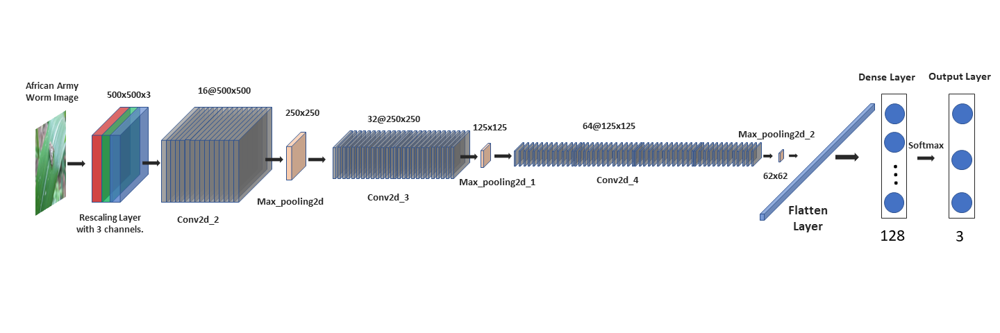

## Transfer Learning

The use of transfer learning for our project is because of the following;

- We do not have a very large dataset to train MothNet to the point where it is robust enough and generalizable for real-world contexts and scenarios.

- We want to compare the inference performance between MothNet, and other pre-trained models modelled on our dataset.

- The model with the most optimal inference performance will be used for our final application.


We are going to make use of two pre-trained models, selected based on;

- some benchmark tests already run by experts that you can find [here](https://developer.nvidia.com/blog/jetson-nano-ai-computing/), 
- our previous experience in using pre-trained models to solve problems,
- and our use-case of deploying to an embedded device which needs a model with low usage of computational resource while serving high throughput during inference stage.


For this project, we will use ResNet-50 and MobileNetV3 pre-trained model which have been found to fit the criteria above.

The approaches we will take for our transfer learning project are;

- Treat pre-trained networks as fixed feature extractors; Here we will use the representations learned by a previous network to extract meaningful features from new samples. We will simply add a new classifier, which will be trained from scratch, on top of the pretrained model so that we can repurpose the feature maps learned previously for the dataset.

> We will not need to (re)train the entire model. The base convolutional network already contains features that are generically useful for classifying pictures. However, the final, classification part of the pretrained model is specific to our original task of classifying the 3 different Moth species for our project.

- Fine-tuning the network for modelling on our dataset.

### ResNet-50

ResNet was first introduced by He et al. in their seminal 2015 paper, Deep Residual Learning for Image Recognition — that paper has been cited over 43,000 times.

The residual networks
won the first ranking in the 2015 ILSVRC (ImageNet Large Scale
Visual Recognition Challenge) image classification task on ImageNet
test set and 2015 COCO (Common Objects in Context) competition for
COCO detection and COCO segmentation (He et al., 2016). In deep
networks, degradation problem occurs due to the increase of network
layers and the accuracy starts to saturate which degrades rapidly. In
ResNet, backpropagation does not encounter the vanishing gradient
problem. A residual neural network has shortcut connections (or skip
connections) which are parallel to the normal convolutional layers that
help the network to understand global features. The shortcut connection
is added to add the input x to the output after a few weight layers
like below;

![Bottleneck residual module of ResNet](https://www.pyimagesearch.com/wp-content/uploads/2020/04/fine_tune_resnet_residual_bottleneck.png)
> Source: https://www.pyimagesearch.com/2020/04/27/fine-tuning-resnet-with-keras-tensorflow-and-deep-learning/

Those shortcut connections allow the network by skipping the
layers that are not useful while training and results in optimal tuning of
the number of layers for faster training. Mathematically, the output H
(x) can be defined by;

$$H_{(x)} = F_{(x)} + x_{(1)}    \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \   (1)$$

The weight layers are actually to learn a kind of residual mapping
which is given by;

$$F_{(x)} = H_{(x)} - x_{(2)} \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ \ (2)$$

and $F_{(x)}$ represents the stacked non-linear weight layers.
In this work, we evaluate the ResNet-50 network for the classification of maize pest species. ResNet-50 is the state-of-the-art pre-trained model from 2015 that was pioneered by researchers from Microsoft. It is a 50-layer neural network that manages to be more accurate but still uses less memory than other pre-trained models like VGG and Inception.

We can inspect the various architectures and model summaries for the ResNet model variants below;

![ResNet Architectures
](https://miro.medium.com/max/700/1*aq0q7gCvuNUqnMHh4cpnIw.png)
> Source: https://medium.com/@14prakash/understanding-and-implementing-architectures-of-resnet-and-resnext-for-state-of-the-art-image-cf51669e1624

As can be seen above ResNet-50
contains a 7×7 convolution layer with 64 kernels, a 3×3 max
pooling layer with stride 2, 16 residual building blocks, a 7×7 average
pooling layer with stride 7 and this is without the fully-connected layer head.


Since our dataset is small and not similar to the ImageNet dataset, we will modify that archtecture by;

- Removing the fully connected nodes at the end of the network (i.e., where the actual class label predictions are made).

- Replacing the fully connected nodes with freshly initialized ones (i.e., using our own defined FC layer with 3 classes as represeted in our dataset).

- Freeze earlier `CONV` layers earlier in the network (ensuring that any previous robust features learned by the CNN are not destroyed).

- Starting the training of the modified netwoek, but only train the FC layer heads.

- Optionally unfreezing some/all of the `CONV` layers in the network and perform a second pass of training.

Here is the final modified ResNet-50 architecture we will use;


![ResNet Arch Modified.png](https://cdn.hashnode.com/res/hashnode/image/upload/v1611852184359/ZGHqBYRaI.png)

Note that we resize the input dimension for our dataset because that is what is ewquired by the input layer of the ResNet-50 architecture.


#### Implementation

In [ ]:
from tensorflow.keras.layers import AveragePooling2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

In [ ]:
import tensorflow_datasets as tfds
IMAGE_SIZE = (224, 224)

In [ ]:
def format_image(image, label):
    image = tf.image.resize(image, IMAGE_SIZE) / 255.0
    return  image, label

In [ ]:
# Creating training data for transfer learning

batch_size = 20

train_gen = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="training",
  seed=123,
  image_size=IMAGE_SIZE,
  batch_size=batch_size)

print("-------"*5)

# Creating validation data
val_gen = tf.keras.preprocessing.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  image_size=IMAGE_SIZE,
  batch_size=batch_size)

Found 1697 files belonging to 3 classes.
Using 1188 files for training.
-----------------------------------
Found 1697 files belonging to 3 classes.
Using 509 files for validation.


In [ ]:
# Create a test batch

val_batches = tf.data.experimental.cardinality(val_gen)
test_gen = val_gen.take(val_batches // 5)
val_gen = val_gen.skip(val_batches // 5)

In [ ]:
train_batches = train_gen.shuffle(num_examples // 4).map(format_image).batch(batch_size).prefetch(1)
validation_batches = val_gen.map(format_image).batch(batch_size).prefetch(1)

In [ ]:
test_gen = val_gen.take(validation_batches // 5)

In [ ]:
test_batches = test_gen.map(format_image).batch(1)

In [ ]:
print('Number of validation batches: %d' % tf.data.experimental.cardinality(validation_batches))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_batches))

Number of validation batches: 21
Number of test batches: 5


In [ ]:
for image_batch, label_batch in train_batches.take(1):
    pass

image_batch.shape

In [ ]:
class_names = train_gen.class_names
print(class_names)

['AAW', 'ECLW', 'FAW']


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_dataset = train_gen.prefetch(buffer_size=AUTOTUNE)
validation_dataset = val_gen.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_gen.prefetch(buffer_size=AUTOTUNE)

In [ ]:
# load the ResNet-50 network, ensuring the head FC layer sets are left
# off
print("[INFO] preparing model...")
baseModel = ResNet50(weights="imagenet", include_top=False,
	input_tensor=Input(shape=(224, 224, 3)))


[INFO] preparing model...
94773248/94765736 [==============================] - 1s 0us/step


In [ ]:
# construct the head of the model that will be placed on top of the
# the base model
headModel = baseModel.output
headModel = AveragePooling2D(pool_size=(7, 7))(headModel)
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(256, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(len(class_names), activation="softmax")(headModel)

In [ ]:
# place the head FC model on top of the base model (this will become
# the actual model we will train)
resnet_model = Model(inputs=baseModel.input, outputs=headModel)

In [ ]:
# loop over all layers in the base model and freeze them so they will
# *not* be updated during the training process
for layer in baseModel.layers:
	layer.trainable = False

In [ ]:
# Folder path to the log files that will contain training statistics
logger = "logs/" + datetime.now().strftime("%Y%m%d-%H%M%S")

tboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logger,
                                                 histogram_freq = 1, # Training stats will be written every epoch
                                                 write_graph=True,
                                                 profile_batch = '500,520') # Profiling all our batches (From 0 to 20)

# checkpoint_path = "resnet_training{}/cp-{epoch:04d}.ckpt"
# checkpoint_dir = os.path.dirname(checkpoint_path)

# # Create a callback that saves the model's weights
# cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
#                                    save_weights_only=True,
#                                    verbose=1)

time: 418 ms (started: 2021-02-04 10:01:21 +00:00)


In [ ]:
NUM_EPOCHS = 20

# compile the model
opt = Adam(lr=1e-4, decay=1e-4 / NUM_EPOCHS)
resnet_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True), 
              optimizer=opt, metrics=["accuracy"])

time: 22.6 ms (started: 2021-02-04 10:03:54 +00:00)


In [ ]:
# Train the model, specifying the callback
epochs = 20

print("[INFO] training model...")
history = resnet_model.fit(
  train_gen,
  validation_data=val_gen,
  shuffle=True,
  epochs=epochs,
  callbacks=[tboard_callback])

[INFO] training model...
Epoch 1/20
60/60 [==============================] - 28s 442ms/step - loss: 0.4351 - accuracy: 0.8258 - val_loss: 0.2634 - val_accuracy: 0.9214
Epoch 2/20
60/60 [==============================] - 28s 444ms/step - loss: 0.3061 - accuracy: 0.8805 - val_loss: 0.2100 - val_accuracy: 0.9214
Epoch 3/20
60/60 [==============================] - 28s 439ms/step - loss: 0.2443 - accuracy: 0.9099 - val_loss: 0.1605 - val_accuracy: 0.9666
Epoch 4/20
60/60 [==============================] - 28s 438ms/step - loss: 0.1836 - accuracy: 0.9436 - val_loss: 0.1348 - val_accuracy: 0.9764
Epoch 5/20
60/60 [==============================] - 28s 438ms/step - loss: 0.1506 - accuracy: 0.9545 - val_loss: 0.1171 - val_accuracy: 0.9745
Epoch 6/20
60/60 [==============================] - 28s 438ms/step - loss: 0.1388 - accuracy: 0.9596 - val_loss: 0.1000 - val_accuracy: 0.9823
Epoch 7/20
60/60 [==============================] - 28s 438ms/step - loss: 0.1134 - accuracy: 0.9638 - val_loss: 0.08

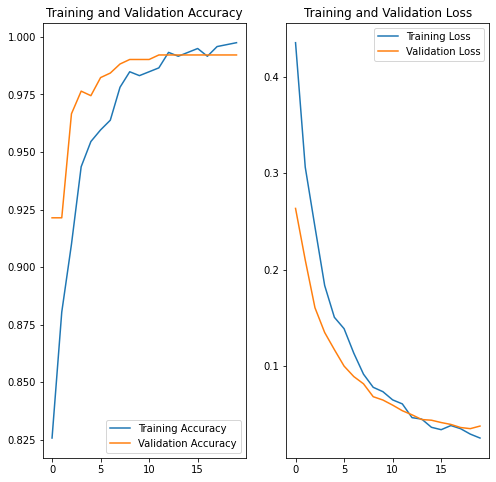

time: 255 ms (started: 2021-02-04 10:17:21 +00:00)


In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
# Launch TensorBoard with objects in the log directory

%tensorboard --logdir=logs 

<IPython.core.display.Javascript object>

time: 5.66 s (started: 2021-02-04 10:17:50 +00:00)


In [ ]:
!tensorboard dev upload --logdir ./logs \
  --name "ResNet-50 for Moth Classification" \
  --description "Experimenting with ResNet-50 for transfer learning for our project." \
  --one_shot

2021-02-04 10:20:34.070439: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) y

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scop

Anyone can now access the results of this experiment [here](https://tensorboard.dev/experiment/K46iZdvZQpio7Ku63HVogw/).

In [ ]:
loss, acc = resnet_model.evaluate(val_gen, verbose=2)

# Print model accuracy
print("Trained ResNet-50 model, accuracy: {:5.2f}%".format(100 * acc))

# Print model loss
print("Trained ResNet-50 model, loss: {:5.2f}%".format(100 * loss))

26/26 - 9s - loss: 0.0379 - accuracy: 0.9921
Trained ResNet-50 model, accuracy: 99.21%
Trained ResNet-50 model, loss:  3.79%
time: 8.72 s (started: 2021-02-04 10:25:06 +00:00)


In [ ]:
# Making predictions with model

################################################
# Testing model directly from Google Drive path
################################################

test_data_dir = '/content/drive/My Drive/.../faw_test.jpg'

img = keras.preprocessing.image.load_img(
    test_data_dir, target_size=(224, 224)
)
img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = resnet_model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f}% confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to FAW with a 57.33 percent confidence.
time: 412 ms (started: 2021-02-04 10:48:21 +00:00)


#### Save ResNet-50 Model

In [ ]:
!cd '/content/drive/MyDrive/.../'

time: 240 ms (started: 2021-02-04 12:24:57 +00:00)


In [ ]:
!mkdir '/content/drive/MyDrive/.../models'

time: 235 ms (started: 2021-02-04 12:25:24 +00:00)


In [ ]:

def save_model_version(model_dir, model_version, model_name, model):
    """Save model version to directory parameter and print success message.

    Args:
          model_dir (str): Directory to save model in.
          model_version (str): The version of the model you want to save.
          model_name (str): Variable name for the trained model.
          model (tensorflow object): The model you want to save.

    Returns:
          Success message.
    """

    export_path = os.path.join(model_dir, 
                               str(model_name), 
                               str(model_version))  # the final path includes the version
    print('Saving model to : {}\n'.format(export_path))

    # if path already exists delete everything at the location
    if os.path.isdir(export_path):
      print('\nPreviously saved model found, deleting it...\n')
      !rm -r {export_path}

    # Save the model  
    tf.saved_model.save(model, export_path)

    # Print save complete message
    print('Model saved successfully!')

time: 6.41 ms (started: 2021-02-04 13:03:03 +00:00)


In [ ]:
model_directory = '/content/drive/MyDrive/.../models'
model_used = "ResNet-50"

save_model_version(model_dir=model_directory, model_version="v_1", 
                   model_name=model_used, model=resnet_model)

Saving model to : /content/drive/MyDrive/UNIPORT AI PROJECT/models/ResNet-50/v_1

INFO:tensorflow:Assets written to: /content/drive/MyDrive/UNIPORT AI PROJECT/models/ResNet-50/v_1/assets
Model saved successfully!
time: 18.3 s (started: 2021-02-04 13:04:29 +00:00)


In [ ]:
model_dir = "/content/drive/MyDrive/export/Servo/model"

save_model_version(model_dir=model_dir, model=new_resnet)

Saving model to : /content/drive/MyDrive/export/Servo/model


Previously saved model found, deleting it...

INFO:tensorflow:Assets written to: /content/drive/MyDrive/export/Servo/model/assets
Model saved successfully!


In [ ]:
import tarfile
with tarfile.open('resnet_model.tar.gz', mode='w:gz') as archive:
    archive.add('/content/drive/MyDrive/export/', recursive=True)

#### Load ResNet-50 Model

In [ ]:
from time import sleep

In [ ]:
# Recreate the exact same model, including its weights and the optimizer

def load_model_version(model_dir, model_name, model_version):
    """Loads model version to directory parameter and print success message.

    Args:
          model_dir (str): Directory to save model in.
          model_name (str): Variable name for the saved model.
          model_version (str): The version of the model you want to save.

    Returns:
          restored_model: (Keras) Model instance.
          Success message.
    """

    import_path = os.path.join(model_dir, str(model_name), str(model_version))

    print('Loading model from : {}\n'.format(import_path))

    sleep(2)

    print("Model loading successfully...")

    try:
      loaded_model = tf.keras.models.load_model(import_path)
      print("Model loaded successfully!")
      return loaded_model
    except:
      print("Model loading failed!")

In [ ]:
model_directory = '/content/drive/MyDrive/moth-class-project/models'
model_used = "ResNet-50"

In [ ]:
new_resnet = load_model_version(model_dir=model_directory, model_name=model_used,
                   model_version="v_1")

Loading model from : /content/drive/MyDrive/moth-class-project/models/ResNet-50/v_1

Model loading successfully...
Model loaded successfully!


In [ ]:
print(list(new_resnet.signatures.keys()))
infer = new_resnet.signatures["serving_default"]
print("Input: ", infer.structured_input_signature)
print("Output: ", infer.structured_outputs)

['serving_default']
Input:  ((), {'input_1': TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='input_1')})
Output:  {'dense_1': TensorSpec(shape=(None, 3), dtype=tf.float32, name='dense_1')}


In [ ]:
new_resnet.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
save_model_version(model_dir=model_dir, model=restored_mothnet)

#### Evaluate Prediction on Test Set

In [ ]:
loss, accuracy = new_resnet.evaluate(test_dataset)
print(f'Test accuracy : {accuracy*100}%')

5/5 [==============================] - 4s 422ms/step - loss: 0.0270 - accuracy: 1.0000
Test accuracy : 100.0%


#### ResNet-50 Model Error Analysis

In [ ]:
image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = new_resnet.predict(image_batch)

In [ ]:
predicted_categories = tf.argmax(predictions, axis=1)
true_categories = tf.concat([y for x, y in validation_dataset], axis=0)

In [ ]:
def view_true_vs_pred(y_pred, pred_categories, image_batch, 
                      true_categories, batch_size):
    """Print predcited classes and categories and plot classified and 
       misclassified classes.

      Args:
          y_pred (list): list of lists of predicted classes.
          pred_categories (list): class of 3 classes model predicted with highest 
                                  confidence.
          image_batch (numpy.ndarray): Array of validation images.
          true_categories (tensor): Array of ground truth labels.
          batch_size (int): Number of batches of images.
      
      Returns:
          Printed lists of; model predictions and labels.
          Plot of correctly classified (green label) and misclassified images 
          (red label).
    """
    print('Predictions:\n', y_pred)
    print('Labels:\n', pred_categories.numpy())

    x = np.ceil(np.sqrt(batch_size))
    y = np.ceil(batch_size / x)
    fig = plt.figure(figsize=(x * 6, y * 7))

    for i, (image, label, prediction) in enumerate(zip(image_batch, 
                                                      true_categories, 
                                                      pred_categories)):
      # Render the image
      ax = fig.add_subplot(x, y, i+1)
      ax.imshow(image.astype("uint8"), aspect='auto')
      ax.grid(False)
      ax.set_xticks([])
      ax.set_yticks([])

      # Display the label and optionally prediction
      x_label = 'Label: ' + class_names[label]
      if prediction is not None:
        x_label = 'Prediction: ' + class_names[pred_categories[i]] + '\n' + x_label
        ax.xaxis.label.set_color('green' if class_names[true_categories[i]] == \
                                class_names[pred_categories[i]] else 'red')
      ax.set_xlabel(x_label, fontsize = 25, fontweight ='bold')

    plt.show()

Predictions:
 [[3.9136829e-03 9.9603003e-01 5.6262059e-05]
 [3.2868355e-03 9.9670780e-01 5.3432377e-06]
 [1.2302319e-04 8.8110240e-03 9.9106592e-01]
 [7.2991897e-05 9.9754035e-01 2.3866592e-03]
 [2.3965231e-04 2.2905357e-03 9.9746978e-01]
 [1.9125326e-05 9.9937928e-01 6.0147594e-04]
 [8.5790773e-05 5.9331756e-05 9.9985480e-01]
 [3.7237667e-04 1.4228427e-01 8.5734332e-01]
 [1.7557648e-04 3.4833420e-02 9.6499103e-01]
 [2.5322614e-03 1.9279225e-01 8.0467546e-01]
 [2.8275370e-04 9.9048436e-01 9.2329010e-03]
 [1.5375975e-03 9.9846208e-01 3.5962387e-07]
 [2.6485601e-05 9.8844260e-01 1.1530827e-02]
 [9.9961275e-01 3.6379718e-04 2.3459084e-05]
 [9.9991918e-01 3.5404239e-05 4.5427358e-05]
 [5.5565215e-03 9.8446345e-01 9.9800043e-03]
 [1.3376294e-04 2.7468148e-05 9.9983871e-01]
 [4.4598972e-05 8.6370914e-05 9.9986899e-01]
 [2.5246558e-05 3.6894955e-05 9.9993789e-01]
 [2.3001255e-03 9.9645090e-01 1.2488838e-03]]
Labels:
 [1 1 2 1 2 1 2 2 2 2 1 1 1 0 0 1 2 2 2 1]


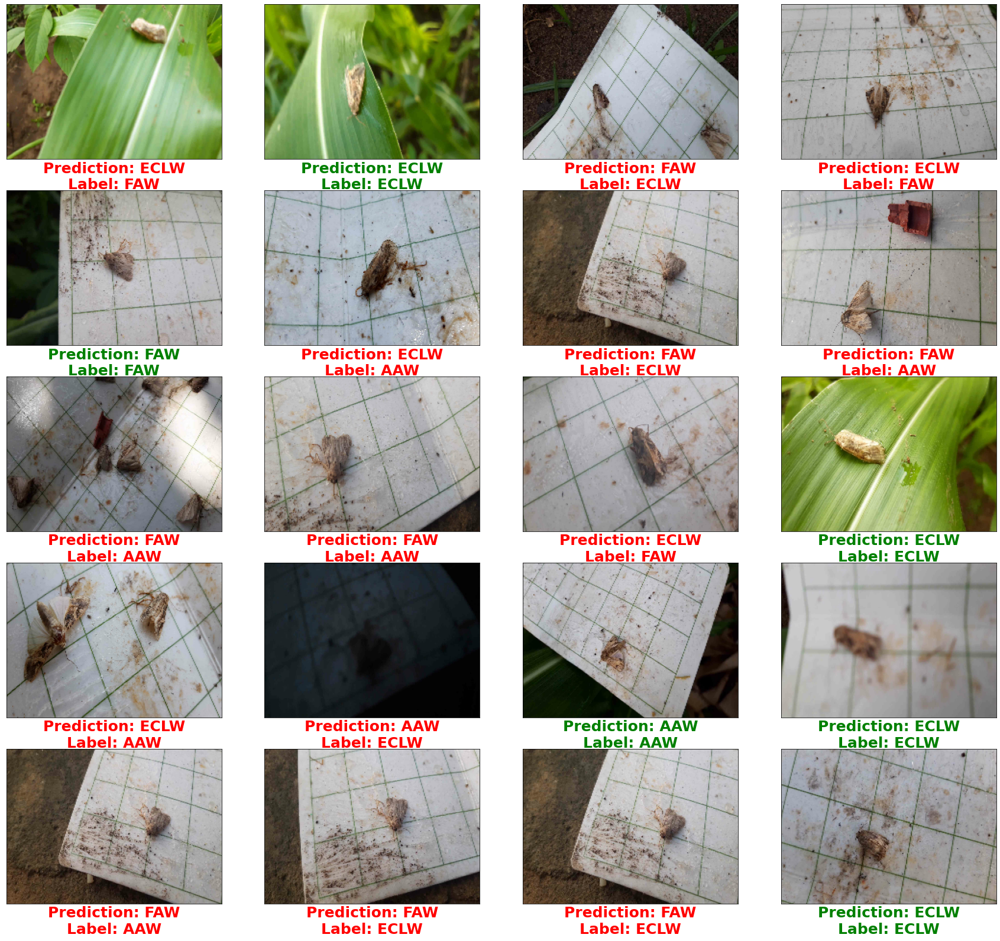

In [ ]:
view_true_vs_pred(predictions, predicted_categories, image_batch, 
                      true_categories, batch_size=20)

#### Making Predictions

In [ ]:
#########################################################
# Testing model by uploading to Colab from local storage.
#########################################################

from google.colab import files
from keras.preprocessing import image

uploaded=files.upload()

for fn in uploaded.keys():
 
  # predicting images
  path='/content/' + fn
  img=image.load_img(path, target_size=(224, 224))

  img_array = keras.preprocessing.image.img_to_array(img)
  img_array = tf.expand_dims(img_array, 0) # Create a batch
  predictions = new_resnet.predict(img_array)
  score = tf.nn.softmax(predictions[0])

  print("-----"*15)
  print("-----"*15)

  print(
      "\n || This image most likely belongs to {} with a {:.2f}% confidence.||\n"
      .format(class_names[np.argmax(score)], 100 * np.max(score))
  )
  
  print("-----"*15)
  print("-----"*15)

Saving 20200409_091203.jpg to 20200409_091203 (2).jpg
---------------------------------------------------------------------------
---------------------------------------------------------------------------

 | This image most likely belongs to ECLW with a 57.15% confidence.|

---------------------------------------------------------------------------
---------------------------------------------------------------------------
time: 1min 52s (started: 2021-02-04 12:14:09 +00:00)


### MobileNetV2

MobileNets is a family of mobile-first computer vision models for TensorFlow, designed to effectively maximize accuracy while being mindful of the restricted resources for an on-device or embedded application. MobileNets are small, low-latency, low-power models parameterized to meet the resource constraints of a variety of use cases. ([Source](https://ai.googleblog.com/2019/11/introducing-next-generation-on-device.html))

The MobileNet model is based on depthwise separable
convolutions--except for
the first layer which is a full convolution, like our standard CNNs--which is a form of factorized convolutions
which factorizes a standard convolution into a depthwise
convolution and a 1x1 convolution called a pointwise convolution.

![contrast-arch.png](https://cdn.hashnode.com/res/hashnode/image/upload/v1612582630445/LhNmV8raj.png)

>The standard convolutional filters in (a) are replaced by
two layers: depthwise convolution in (b) and pointwise convolution
in (c) to build a depthwise separable filter.

For MobileNets the depthwise convolution applies
a single filter to each input channel. The pointwise
convolution then applies a 11 convolution to combine the
outputs the depthwise convolution. A standard convolution
both filters and combines inputs into a new set of outputs
in one step. The depthwise separable convolution splits this
into two layers, a separate layer for filtering and a separate
layer for combining. This factorization has the effect of
drastically reducing computation and model size.
[Source: Andrew G. Howard et. al *MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications* 2017 pg. 2].

MobileNet uses 3 x 3 depthwise separable convolutions
which uses between 8 to 9 times less computation than standard
convolutions at only a small reduction in accuracy.

The MobileNet
architecture is defined below;

![mobilenet-body-arch.png](https://cdn.hashnode.com/res/hashnode/image/upload/v1612582625402/CcpmtPGmO.png)

> [Source: Andrew G. Howard et. al *MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications* 2017 pg. 24.

As you can see from the architecture above, all layers are followed by
a batchnorm [13] and ReLU nonlinearity with the exception
of the final fully connected layer which has no nonlinearity
and feeds into a softmax layer for classification.

![mobile - net.png](https://cdn.hashnode.com/res/hashnode/image/upload/v1612582598676/KLEvEDV_u.png)

> [Source: Andrew G. Howard et. al *MobileNets: Efficient Convolutional Neural Networks for Mobile Vision
Applications* 2017 pg. 4].

The figure above contrasts a layer with regular convolutions, batchnorm and
ReLU nonlinearity to the factorized layer with depthwise
convolution, 1 x 1 pointwise convolution as well as batchnorm
and ReLU after each convolutional layer. 

Down-sampling is handled with strided convolution in the depthwise
convolutions as well as in the first layer. A final average
pooling reduces the spatial resolution to 1 before the fully
connected layer. **Counting depthwise and pointwise convolutions
as separate layers, MobileNet has 28 layers.**

##### How MobileNet Models Were Trained

MobileNet models were trained in TensorFlow [1] using
RMSprop [33] with asynchronous gradient descent similar
to Inception V3 [31]. 

However, contrary to training
large models the researchers (Andrew G. Howard, et al. at Google Inc.) used less regularization and data augmentation
techniques because small models have less trouble
with overfitting.

---

[1] M. Abadi, A. Agarwal, P. Barham, E. Brevdo, Z. Chen,
C. Citro, G. S. Corrado, A. Davis, J. Dean, M. Devin, et al.
Tensorflow: Large-scale machine learning on heterogeneous
systems, 2015. Software available from tensorflow. org, 1,
2015.

[13] S. Ioffe and C. Szegedy. Batch normalization: Accelerating
deep network training by reducing internal covariate shift.
arXiv preprint arXiv:1502.03167, 2015.

[31] C. Szegedy, V. Vanhoucke, S. Ioffe, J. Shlens, and Z. Wojna.
Rethinking the inception architecture for computer vision.
arXiv preprint arXiv:1512.00567, 2015.

[33] T. Tieleman and G. Hinton. Lecture 6.5-rmsprop: Divide
the gradient by a running average of its recent magnitude.
COURSERA: Neural Networks for Machine Learning, 4(2),
2012.






In [ ]:
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

In [ ]:
# Create the base model from the pre-trained model MobileNet V2
IMG_SHAPE = (224, 224) + (3,)
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

9412608/9406464 [==============================] - 0s 0us/step


In [ ]:
image_batch, label_batch = next(iter(train_dataset))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(20, 7, 7, 1280)


In [ ]:
base_model.trainable = False

In [ ]:
# Let's take a look at the base model architecture
base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   
_______________________________________________________________________________

#### Add a Classification Head to the Base Model

In [ ]:
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(20, 1280)


In [ ]:
prediction_layer = tf.keras.layers.Dense(3, activation='softmax')

prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(20, 3)


In [ ]:
inputs = tf.keras.Input(shape=(224, 224, 3))
x = preprocess_input(inputs)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs)

In [ ]:
base_learning_rate = 0.0001
mobilenet_model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
mobilenet_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1280)              2257984   
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 2,227,715
Non-trainable params: 34,112
_________________________________________________________________


In [ ]:
len(mobilenet_model.trainable_variables)

158

In [ ]:
initial_epochs = 10

loss0, accuracy0 = mobilenet_model.evaluate(validation_dataset)

21/21 [==============================] - 82s 4s/step - loss: 1.2579 - accuracy: 0.3789


In [ ]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 1.26
initial accuracy: 0.37


In [ ]:
history = mobilenet_model.fit(train_dataset,
                    epochs=initial_epochs,
                    validation_data=validation_dataset)

Epoch 1/10
60/60 [==============================] - 29s 380ms/step - loss: 0.4499 - accuracy: 0.8476 - val_loss: 0.2865 - val_accuracy: 0.9487
Epoch 2/10
60/60 [==============================] - 24s 373ms/step - loss: 0.1189 - accuracy: 0.9983 - val_loss: 0.1239 - val_accuracy: 0.9927
Epoch 3/10
60/60 [==============================] - 24s 377ms/step - loss: 0.0947 - accuracy: 1.0000 - val_loss: 0.0989 - val_accuracy: 0.9976
Epoch 4/10
60/60 [==============================] - 24s 373ms/step - loss: 0.0929 - accuracy: 0.9992 - val_loss: 0.0938 - val_accuracy: 0.9976
Epoch 5/10
60/60 [==============================] - 24s 376ms/step - loss: 0.0929 - accuracy: 0.9992 - val_loss: 0.0965 - val_accuracy: 0.9976
Epoch 6/10
60/60 [==============================] - 24s 376ms/step - loss: 0.0905 - accuracy: 0.9992 - val_loss: 0.0897 - val_accuracy: 0.9976
Epoch 7/10
60/60 [==============================] - 24s 374ms/step - loss: 0.0871 - accuracy: 1.0000 - val_loss: 0.0890 - val_accuracy: 0.9976

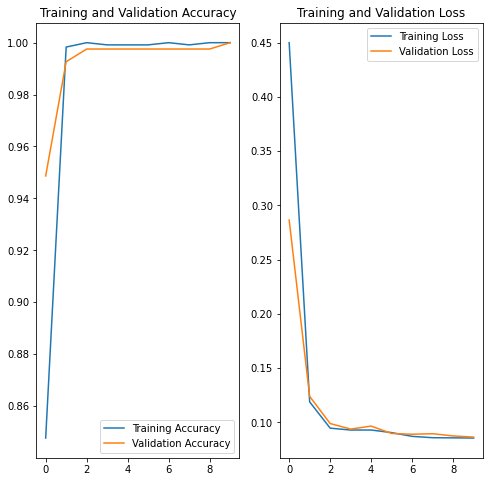

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(10)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

#### Fine tuning

In [ ]:
base_model.trainable = True

In [ ]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  154


In [ ]:
mobilenet_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [ ]:
mobilenet_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1280)              2257984   
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 2,227,715
Non-trainable params: 34,112
_________________________________________________________________


In [ ]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = mobilenet_model.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_dataset)

Epoch 10/20
60/60 [==============================] - 27s 381ms/step - loss: 0.0848 - accuracy: 1.0000 - val_loss: 0.0866 - val_accuracy: 1.0000
Epoch 11/20
60/60 [==============================] - 24s 375ms/step - loss: 0.0835 - accuracy: 1.0000 - val_loss: 0.0864 - val_accuracy: 1.0000
Epoch 12/20
60/60 [==============================] - 24s 376ms/step - loss: 0.0839 - accuracy: 1.0000 - val_loss: 0.0854 - val_accuracy: 1.0000
Epoch 13/20
60/60 [==============================] - 24s 375ms/step - loss: 0.0834 - accuracy: 1.0000 - val_loss: 0.0865 - val_accuracy: 1.0000
Epoch 14/20
60/60 [==============================] - 24s 375ms/step - loss: 0.0835 - accuracy: 1.0000 - val_loss: 0.0862 - val_accuracy: 1.0000
Epoch 15/20
60/60 [==============================] - 24s 378ms/step - loss: 0.0848 - accuracy: 1.0000 - val_loss: 0.0880 - val_accuracy: 0.9976
Epoch 16/20
60/60 [==============================] - 24s 374ms/step - loss: 0.0869 - accuracy: 1.0000 - val_loss: 0.0879 - val_accuracy:

In [ ]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

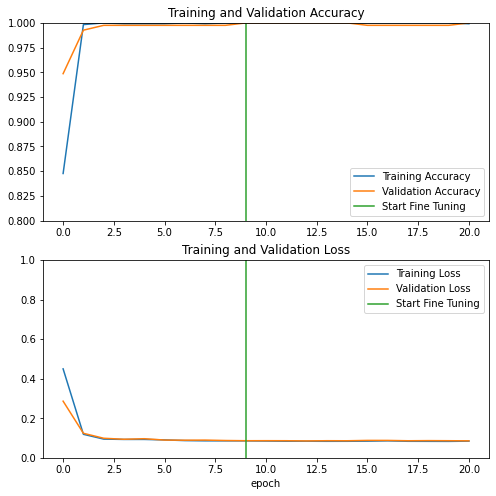

In [ ]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

The model clearly overfits here...

#### Evaluate Prediction

In [ ]:
loss, accuracy = mobilenet_model.evaluate(test_dataset)
print(f'Test accuracy : {accuracy*100}%')

5/5 [==============================] - 4s 393ms/step - loss: 0.0834 - accuracy: 1.0000
Test accuracy : 100.0%


#### MobileNetV2 Error Analysis

In [ ]:
image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = mobilenet_model.predict(image_batch)

In [ ]:
predicted_categories = tf.argmax(predictions, axis=1)
true_categories = tf.concat([y for x, y in validation_dataset], axis=0)

In [ ]:
def view_true_vs_pred(y_pred, pred_categories, image_batch, 
                      true_categories, batch_size):
    """Print predcited classes and categories and plot classified and 
       misclassified classes.

      Args:
          y_pred (list): list of lists of predicted classes.
          pred_categories (list): class of 3 classes model predicted with highest 
                                  confidence.
          image_batch (numpy.ndarray): Array of validation images.
          true_categories (tensor): Array of ground truth labels.
          batch_size (int): Number of batches of images.
      
      Returns:
          Printed lists of; model predictions and labels.
          Plot of correctly classified (green label) and misclassified images 
          (red label).
    """
    print('Predictions:\n', y_pred)
    print('Labels:\n', pred_categories.numpy())

    x = np.ceil(np.sqrt(batch_size))
    y = np.ceil(batch_size / x)
    fig = plt.figure(figsize=(x * 6, y * 7))

    for i, (image, label, prediction) in enumerate(zip(image_batch, 
                                                      true_categories, 
                                                      pred_categories)):
      # Render the image
      ax = fig.add_subplot(x, y, i+1)
      ax.imshow(image.astype("uint8"), aspect='auto')
      ax.grid(False)
      ax.set_xticks([])
      ax.set_yticks([])

      # Display the label and optionally prediction
      x_label = 'Label: ' + class_names[label]
      if prediction is not None:
        x_label = 'Prediction: ' + class_names[pred_categories[i]] + '\n' + x_label
        ax.xaxis.label.set_color('green' if class_names[true_categories[i]] == \
                                class_names[pred_categories[i]] else 'red')
      ax.set_xlabel(x_label, fontsize = 25, fontweight ='bold')

    plt.show()

Predictions:
 [[6.69011752e-06 9.99992132e-01 1.16170816e-06]
 [5.18929028e-06 9.99991655e-01 3.07148434e-06]
 [4.60460939e-07 9.99998093e-01 1.47295100e-06]
 [3.94359522e-05 9.99925852e-01 3.47215791e-05]
 [2.59754643e-07 9.99994397e-01 5.42161797e-06]
 [9.99995947e-01 3.37104666e-07 3.64367611e-06]
 [1.60289005e-06 9.99986649e-01 1.17639975e-05]
 [9.99999046e-01 2.71219193e-07 7.34614844e-07]
 [1.34439097e-06 5.92751576e-07 9.99998093e-01]
 [1.70751619e-07 9.99999642e-01 2.42005626e-07]
 [9.99999642e-01 2.12398277e-07 1.78706713e-07]
 [1.39076451e-06 8.07322806e-07 9.99997854e-01]
 [3.18856996e-06 1.37335280e-06 9.99995470e-01]
 [1.19058013e-05 3.09910174e-05 9.99957085e-01]
 [7.44287627e-06 1.18727620e-07 9.99992490e-01]
 [2.13501312e-06 9.99969125e-01 2.86712111e-05]
 [9.99976635e-01 6.96143843e-06 1.64132416e-05]
 [6.31845114e-06 1.09650837e-05 9.99982715e-01]
 [9.99999285e-01 1.81838814e-07 4.57673593e-07]
 [9.99999285e-01 9.77751640e-08 6.53497864e-07]]
Labels:
 [1 1 1 1 1 0 1 0

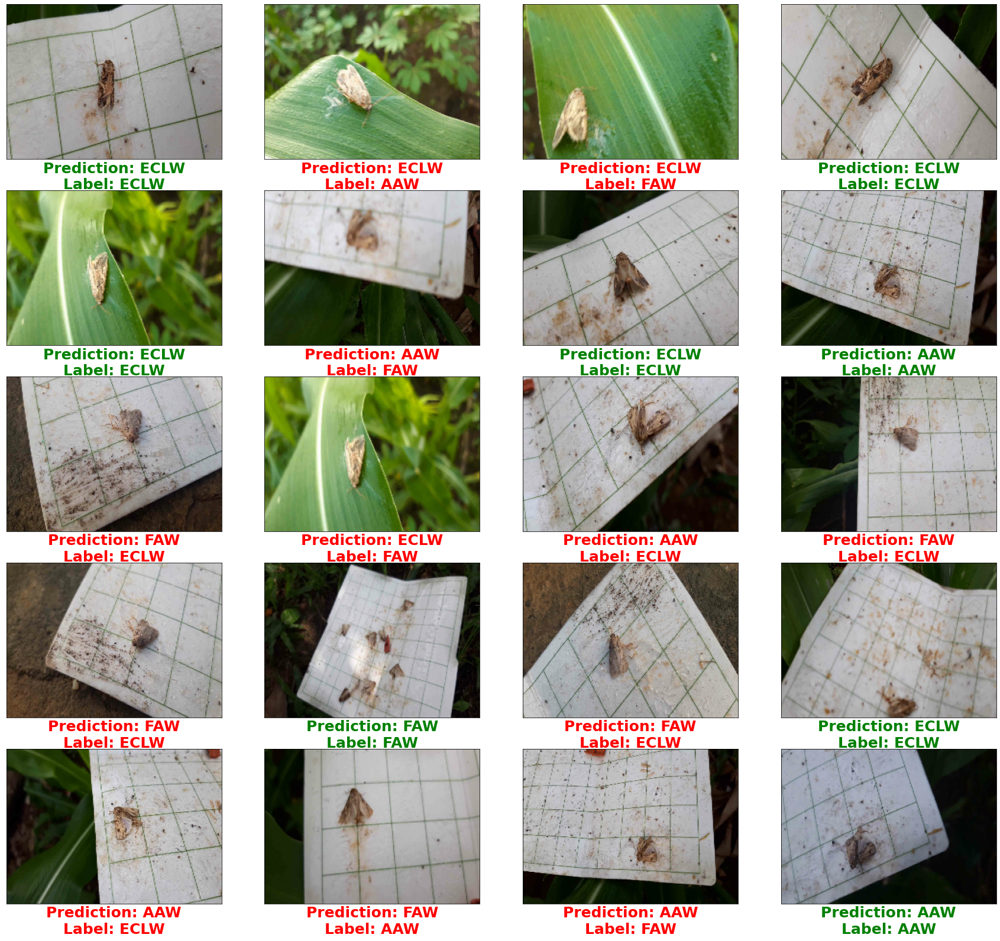

In [ ]:
view_true_vs_pred(predictions, predicted_categories, image_batch, 
                      true_categories, batch_size=20)

As we can see, the MobileNet model performs poorly in predicting the test dataset despite the fact that the accuracy of the model is about 100%.

## Comparing All 3 Models

### MothNet Evaluation on Test Set

In [ ]:

loss_mothnet, acc_mothnet = restored_mothnet.evaluate(test_ds, verbose=2)

# Print model accuracy
print("Trained MothNet model, accuracy: {:5.2f}%".format(100 * acc_mothnet))

# Print model loss
print("Trained MothNet model, loss: {:5.2f}%".format(100 * loss_mothnet))

5/5 - 4s - loss: 0.1838 - accuracy: 0.9100
Trained MothNet model, accuracy: 91.00%
Trained MothNet model, loss: 18.38%


### ResNet Evaluation

In [ ]:

loss_resnet, acc_resnet = new_resnet.evaluate(test_dataset, verbose=2)

# Print model accuracy
print("Trained ResNet-50 Model, accuracy: {:5.2f}%".format(100 * acc_resnet))

# Print model loss
print("Trained ResNet-50 Model, loss: {:5.2f}%".format(100 * loss_resnet))

5/5 - 3s - loss: 0.0435 - accuracy: 0.9900
Trained ResNet-50 Model, accuracy: 99.00%
Trained ResNet-50 Model, loss:  4.35%


### MobileNet Evaluation

In [ ]:

loss_mobilenet, acc_mobilenet = mobilenet_model.evaluate(test_dataset, verbose=2)

# Print model accuracy
print("Trained MobileNetV2 Model, accuracy: {:5.2f}%".format(100 * acc_mobilenet))

# Print model loss
print("Trained  MobileNetV2 Model, loss: {:5.2f}%".format(100 * loss_mobilenet))

5/5 - 3s - loss: 0.0894 - accuracy: 1.0000
Trained MobileNetV2 Model, accuracy: 100.00%
Trained  MobileNetV2 Model, loss:  8.94%


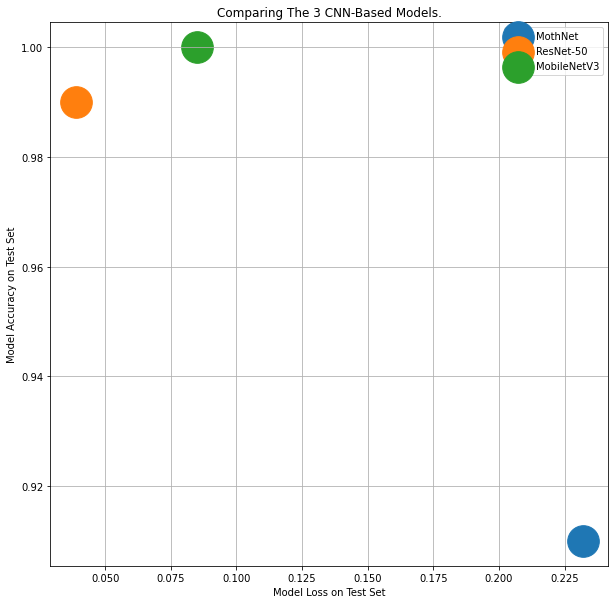

In [ ]:
plt.figure(figsize=(10, 10))
plt.scatter(loss_mothnet, acc_mothnet, s=1000, label='MothNet')
plt.scatter(loss_resnet, acc_resnet,  s=1000, label='ResNet-50')
plt.scatter(loss_mobilenet, acc_mobilenet,  s=1000, label='MobileNetV3')
plt.xlabel("Model Loss on Test Set")
plt.ylabel("Model Accuracy on Test Set")
plt.legend(loc='upper right')
plt.title('Comparing The 3 CNN-Based Models.')
plt.grid(True)
plt.show()

## Conclusion

As we can see from the graph above, ResNet-50 looks like the most promising model to use because compared to other models, it exhibits low loss and high accuracy.

But in fact, we will test our both our custom architecture (MothNet) and the ResNet-50 model on our NVIDIA Jetson Nano device to see what performance we can get in production.

In conclusion, we'll convert and use two models; ResNet-50 model and MothNet model.

## Converting Our Models to Use On NVIDIA Jetson Nano Device.

#### Implementation: Convert Using TFLite's Converter

![TensorFlow Lite Converter Architecture](https://cdn.hashnode.com/res/hashnode/image/upload/v1612732059734/QYGfALc33.png)

> Source: Modified diagram. Original concept from Deeplearning.ai course [Device-based Models with TensorFlow Lite](https://www.coursera.org/learn/device-based-models-tensorflow/lecture/64CAo/saving-converting-and-optimizing-a-model) 

In [ ]:
# Change this from saved model --> model in the dev environment.
converter = tf.lite.TFLiteConverter.from_keras_model(new_resnet)

In [ ]:
_model(restored_mothnet)

### Post-Training Quantization

At inference, weights from the model are converted from 8-bits of precision to floating point and computed using floating-point kernels. This conversion is done once and cached to reduce latency. Nvidia Jetson Nano supports floating point (FP16) and integer (INT8) operations. TensorFlow Lite converter uses floating point operation as a default (for inference stage) unless specified through post-training integer quantization or other means.

The diagram below shows us how to select an optimal conversio path for any TensorFlow Lite model.

![How to Choose The Optimal Conversion Path](https://cdn.hashnode.com/res/hashnode/image/upload/v1612731277592/x1bkOi2Zj.png)

> Source: Original concept from Deeplearning.ai course [Device-based Models with TensorFlow Lite](https://www.coursera.org/learn/device-based-models-tensorflow/lecture/caqPx/paths-in-optimization).  

### Post-Training Quantization


We are using post-training quantization adn will opt to optimize the model to be converted for latency because the other trade-off is in size (storage) and this is not a problem for our NVIDIA Jetson Nano device as it has a large memory (about 32GB external memory before OS image installation and 23GB memory left after OS image installation and installation of other libraries and builds).

Our device also has low-power consumption pack at 5W/10W so a heavy use of power as a trade-off for high-speed real-time inference should not be a problem for our set-up.

We chose to optimize for latency because the round trip from observed and ingested images from the Raspberry Pi camera, to the NVIDIA Jetson Nano device, up to the Cloud environment and finally to the mobile application already takes up some few seconds up to few minutes, so optimizing for speed over size seems pretty engineering efficient on our end.

In [ ]:
'/content/drive/MyDrive/UNIPORT AI PROJECT/MothNet.h5'

In [ ]:
saved_model_path = '/content/drive/MyDrive/UNIPORT AI PROJECT/models/ResNet-50/v_1'

In [ ]:
%%bash -s $saved_model_path
saved_model_cli show --dir $1 --tag_set serve --signature_def serving_default

In [ ]:
loaded = tf.saved_model.load(saved_model_path)

In [ ]:
print(list(loaded.signatures.keys()))
infer = loaded.signatures["serving_default"]
print(infer.structured_input_signature)
print(infer.structured_outputs)

In [ ]:
converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_path) 
# tflite_model = converter.convert()
# open("converted_model.tflite", "wb").write(tflite_model)

96050328

In [ ]:
converter.optimizations = [tf.lite.Optimize.DEFAULT]

In [ ]:
def representative_data_gen():
    for input_value, _ in test_batches.take(100):
        yield [input_value]

In [ ]:
converter.representative_dataset = representative_data_gen

In [ ]:
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]

In [ ]:
tflite_model_file = 'converted_model.tflite'

with open(tflite_model_file, "wb") as f:
    f.write(tflite_model)

In [ ]:
# Load TFLite model and allocate tensors.
  
interpreter = tf.lite.Interpreter(model_path=tflite_model_file)
interpreter.allocate_tensors()

input_index = interpreter.get_input_details()[0]["index"]
output_index = interpreter.get_output_details()[0]["index"]

In [ ]:
# Gather results for the randomly sampled test images
predictions = []

test_labels, test_imgs = [], []
for img, label in tqdm(test_batches.take(10)):
    interpreter.set_tensor(input_index, img)
    interpreter.invoke()
    predictions.append(interpreter.get_tensor(output_index))
    
    test_labels.append(label.numpy()[0])
    test_imgs.append(img)

In [ ]:
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details= interpreter.get_output_details()
interpreter.resize_tensor_input(input_details[0]['index'],(20, 224, 224, 3))
interpreter.resize_tensor_input(output_details[0]['index'], (25, 224,224,3))
interpreter.allocate_tensors()

In [ ]:
image_batch, label_batch = next(iter(test_gen))
interpreter.set_tensor(input_details[0]['index'], image_batch)
interpreter.invoke()
tflite_results = interpreter.get_tensor(output_details[0]['index'])

In [ ]:
print(tflite_results)

In [ ]:
# Gather results for the randomly sampled test images
predictions = []

test_labels, test_imgs = [], []
for img, label in tqdm(test_gen.take(3)):
    interpreter.set_tensor(input_details[0]['index'], img)
    interpreter.invoke()
    predictions.append(interpreter.get_tensor(output_details[0]['index']))
    
    test_labels.append(label.numpy()[0])
    test_imgs.append(img)

100%|██████████| 3/3 [00:10<00:00,  3.34s/it]


In [ ]:
print(np.array(test_imgs).shape)

(3, 20, 224, 224, 3)


In [ ]:
  def plot_image(i, predictions_array, true_label, img):
    predictions_array, true_label, img = predictions_array[i], true_label[i], img[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    img = np.squeeze(img)

    plt.imshow(img, cmap=plt.cm.binary, aspect='auto')
    
    predicted_label = np.argmax(predictions_array)
    
    if predicted_label == true_label:
        color = 'green'
    else:
        color = 'red'
    
    plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                         100*np.max(predictions_array),
                                         class_names[true_label]), color=color)

TypeError: ignored

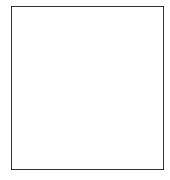

In [ ]:
index = 2
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(index, predictions, test_labels, test_imgs)
plt.show()

TypeError: ignored

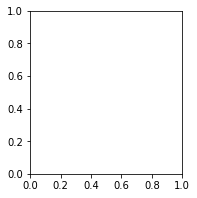

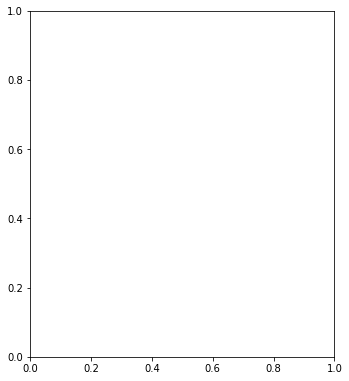

In [ ]:

plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
view_true_vs_pred(predictions, test_imgs, test_labels, batch_size=3)
plt.show()

#### Finally convert the model

In [ ]:
tflite_model = converter.convert()
tflite_model_file = 'converted_model.tflite'

with open(tflite_model_file, "wb") as f:
    f.write(tflite_model)

INFO:tensorflow:Assets written to: /tmp/tmphhla54m7/assets


In [ ]:
def load_image(path):
  image_raw = tf.io.read_file(path)
  image = tf.image.decode_image(image_raw, channels=3)
  return image

(2240, 4608, 3)


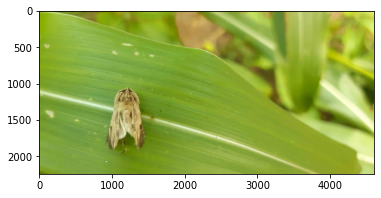

In [ ]:
test_image_original = load_image("/content/drive/MyDrive/.../test_data/aaw_test.jpg")
print(test_image_original.shape)
plt.imshow(test_image_original)
plt.show()

In [ ]:
def resize(image):
    resized_image =  tf.image.resize(image, [500, 500], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    resized_image = tf.cast(resized_image, tf.float32)
    resized_image = tf.expand_dims(resized_image, 0)

    return resized_image

In [ ]:
test_image_resized = resize(test_image_original)
test_image_resized.shape

TensorShape([1, 500, 500, 3])

In [ ]:
with tf.io.gfile.GFile('/content/converted_model.tflite', 'rb') as f:
    model_content = f.read()

# Initialze TensorFlow Lite inpterpreter.
interpreter = tf.lite.Interpreter(model_content=model_content)
interpreter.allocate_tensors()
input_index = interpreter.get_input_details()[0]['index']
output = interpreter.tensor(interpreter.get_output_details()[0]["index"])

In [ ]:
image_batch, label_batch = next(iter(test_ds))
interpreter.set_tensor(input_index[0]['index'], image_batch)
interpreter.invoke()
tflite_results = interpreter.get_tensor(output[0]['index'])

TypeError: ignored

In [ ]:
def predict_classes(tf_lite_interpreter, y):
    tf_lite_interpreter.set_tensor(input_details[0]['index'], y)
    tf_lite_interpreter.invoke()
    tflite_results = tf_lite_interpreter.get_tensor(output_details[0]['index'])
if tflite_results.shape[-1] > 1:
        tflite_results = tflite_results.argmax(axis=-1)
    else:
        tflite_results = (tflite_results > 0.5).astype('int32')
plt.figure(figsize=(22,20))
    for n in range(10):
        plt.subplot(6,6,n+1)
        plt.subplots_adjust(hspace = 0.3)
        plt.imshow(image_batch[n])
        if  tflite_results[n] < 0.5 color = "green"  else "red"
            if color = "green"  then plt.title='Mask' else plt.title='UnMask'
            plt.title(tflite_results[n], color=color)
            plt.axis('off')
           _ = plt.suptitle("Model predictions (green: Mask, red: Unmask)")
print("Model predictions (green: Mask, red: Unmask)")
predict_classes( interpreter, image_batch)
print(predict_classes)

In [ ]:
def convert_to_tflite(tf_model):
    converter = tf.lite.TFLiteConverter.from_keras_model(tf_model)

    converter.optimizations = [tf.lite.Optimize.DEFAULT]
    converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS,
                                        tf.lite.OpsSet.SELECT_TF_OPS]

    # Convert to TFLite Model
    tflite_model = converter.convert()

    _, tflite_path = tempfile.mkstemp('.tflite')
    tflite_model_size = open(tflite_path, 'wb').write(tflite_model)
    tf_model_size = os.path.getsize('/content/drive/MyDrive/.../models/ResNet-50/v_1/saved_model.pb')
    print('TensorFlow Model is  {} bytes'.format(tf_model_size))
    print('TFLite Model is      {} bytes'.format(tflite_model_size))
    print('Post training dynamic range quantization saves {} bytes'.format(
        tf_model_size-tflite_model_size))
    print('Saved TF Lite model to: {}'.format(tflite_path))



In [ ]:
convert_to_tflite(new_resnet)

INFO:tensorflow:Assets written to: /tmp/tmp7g_9ox5v/assets


INFO:tensorflow:Assets written to: /tmp/tmp7g_9ox5v/assets


TensorFlow Model is  3805241 bytes
TFLite Model is      24665264 bytes
Post training dynamic range quantization saves -20860023 bytes
Saved TF Lite model to: /tmp/tmpwhcckh1n.tflite


In [ ]:
!cp /tmp/tmpwhcckh1n.tflite resnet_model.tflite

In [ ]:
#@title Download The Converted ResNet Model { run: "auto" }
# Download the TF Lite files 
option = "Yes" #@param ["Yes", "No"]

if option == "Yes":
  from google.colab import files
  files.download('converted_model.tflite')
elif option == "No":
  pass

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Test the TFLite ResNet-50 Model Using the Python Interpreter

In [ ]:
# Load TFLite model and allocate tensors.
with open(tflite_model_file, 'rb') as fid:
    tflite_model = fid.read()
    
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()

input_index = interpreter.get_input_details()
output_index = interpreter.get_output_details()

In [ ]:
from tqdm import tqdm

In [ ]:
print(interpreter.get_input_details())

[{'name': 'sequential_input', 'index': 0, 'shape': array([  1, 500, 500,   3], dtype=int32), 'shape_signature': array([ -1, 500, 500,   3], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}]


In [ ]:
# Gather results for the randomly sampled test images
predictions = []

test_labels, test_imgs = [], []
for img, label in tqdm(test_ds.take(1)):
    interpreter.set_tensor(input_index[0]["index"], img)
    interpreter.invoke()
    predictions.append(interpreter.get_tensor(output_index[0]["index"]))
    test_labels.append(label.numpy()[0])
    test_imgs.append(img)

  0%|          | 0/1 [00:02<?, ?it/s]


ValueError: ignored

In [ ]:
# Run the model with TensorFlow to get expected results.
TEST_CASES = 10

# Run the model with TensorFlow Lite
interpreter = tf.lite.Interpreter(model_content=tflite_model)
interpreter.allocate_tensors()
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

for i in range(TEST_CASES):
  expected = new_resnet.predict(test_gen[i:i+1])
  interpreter.set_tensor(input_details[0]["index"], test_gen[i:i+1, :, :])
  interpreter.invoke()
  result = interpreter.get_tensor(output_details[0]["index"])

  # Assert if the result of TFLite model is consistent with the TF model.
  np.testing.assert_almost_equal(expected, result)
  print("Done. The result of TensorFlow matches the result of TensorFlow Lite.")

  # Please note: TfLite fused Lstm kernel is stateful, so we need to reset
  # the states.
  # Clean up internal states.
  interpreter.reset_all_variables()

In [ ]:
def evaluate_model(interpreter):
  input_index = interpreter.get_input_details()[0]["index"]
  output_index = interpreter.get_output_details()[0]["index"]

  # Run predictions on ever y image in the "test" dataset.
  prediction_digits = []
  for i, test_image in enumerate(test_images):
    if i % 1000 == 0:
      print('Evaluated on {n} results so far.'.format(n=i))
    # Pre-processing: add batch dimension and convert to float32 to match with
    # the model's input data format.
    test_image = np.expand_dims(test_image, axis=0).astype(np.float32)
    interpreter.set_tensor(input_index, test_image)

    # Run inference.
    interpreter.invoke()

    # Post-processing: remove batch dimension and find the digit with highest
    # probability.
    output = interpreter.tensor(output_index)
    digit = np.argmax(output()[0])
    prediction_digits.append(digit)

  print('\n')
  # Compare prediction results with ground truth labels to calculate accuracy.
  prediction_digits = np.array(prediction_digits)
  accuracy = (prediction_digits == test_labels).mean()
  return accuracy

In [ ]:
# Load TFLite model and allocate tensors.
  
interpreter = tf.lite.Interpreter(model_path='resnet_model.tflite')
interpreter.allocate_tensors()

input_index = interpreter.get_input_details()[0]["index"]
output_index = interpreter.get_output_details()[0]["index"]

In [ ]:
from tqdm import tqdm

Create a file to save the labels...

In [ ]:
labels = ['AAW', 'ECLW', 'FAW']

with open('labels.txt', 'w') as f:
    f.write('\n'.join(labels))

Since we are running this notebook in Colab (managed notebook environment), we will run the cell below to download the model and labels to our local disk so we can make inference with the Nvidia Jetson Nano device.

**Note for Cell Executor**: If the files do not download when you run the cell, try running the cell a second time. Your browser might prompt you to allow multiple files to be downloaded.

In [ ]:
try:
    from google.colab import files
    files.download('converted_resnet_model.tflite')
    files.download('labels.txt')
except:
    pass